<a href="https://colab.research.google.com/github/carissa406/deep-learning-535/blob/main/Carissa_Hicks_Final_Project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Classifying Artist by Art

https://www.kaggle.com/datasets/ikarus777/best-artworks-of-all-time

In [ ]:
import zipfile, os
import shutil
import math
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import random

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.models import load_model
from tensorflow.keras.models import Model
import tensorflow.keras.utils 

In [ ]:
#getting the data from UIS dropbox
!wget --no-check-certificate "https://uofi.box.com/shared/static/5wp34g21h6mizophfdowv487llgkkya3.zip" -O artbyartist.zip

--2022-12-02 17:29:05--  https://uofi.box.com/shared/static/5wp34g21h6mizophfdowv487llgkkya3.zip
Resolving uofi.box.com (uofi.box.com)... 74.112.186.144
Connecting to uofi.box.com (uofi.box.com)|74.112.186.144|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: /public/static/5wp34g21h6mizophfdowv487llgkkya3.zip [following]
--2022-12-02 17:29:05--  https://uofi.box.com/public/static/5wp34g21h6mizophfdowv487llgkkya3.zip
Reusing existing connection to uofi.box.com:443.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://uofi.app.box.com/public/static/5wp34g21h6mizophfdowv487llgkkya3.zip [following]
--2022-12-02 17:29:06--  https://uofi.app.box.com/public/static/5wp34g21h6mizophfdowv487llgkkya3.zip
Resolving uofi.app.box.com (uofi.app.box.com)... 74.112.186.144
Connecting to uofi.app.box.com (uofi.app.box.com)|74.112.186.144|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: https://dl2.boxcloud

In [ ]:
#extract the zip file
with zipfile.ZipFile("artbyartist.zip", "r") as zip_ref:
  zip_ref.extractall()

# Data Exploration and Preprocessing

#### Organizing files for training, validation and testing

In [ ]:
print("List of " + str(len(os.listdir("images/images"))) + " Artists in the dataset and total number of images:")
for i in os.listdir("images/images"):
                    print(i + " - " + str(len(os.listdir("images/images/" + str(i)))))

List of 51 Artists in the dataset and total number of images:
Rene_Magritte - 194
Frida_Kahlo - 120
Mikhail_Vrubel - 171
Pieter_Bruegel - 134
Pierre-Auguste_Renoir - 336
Edouard_Manet - 90
Jan_van_Eyck - 81
Andrei_Rublev - 99
Alfred_Sisley - 259
Jackson_Pollock - 24
Raphael - 109
Claude_Monet - 73
Leonardo_da_Vinci - 143
Vincent_van_Gogh - 877
Eugene_Delacroix - 31
Kazimir_Malevich - 126
Gustav_Klimt - 117
Henri_Rousseau - 70
Edgar_Degas - 702
Michelangelo - 49
El_Greco - 87
Peter_Paul_Rubens - 141
Pablo_Picasso - 439
Marc_Chagall - 239
Hieronymus_Bosch - 137
Caravaggio - 55
Diego_Velazquez - 128
Albrecht_Du╠êrer - 328
Paul_Cezanne - 47
Camille_Pissarro - 91
Henri_de_Toulouse-Lautrec - 81
Henri_Matisse - 186
Salvador_Dali - 139
Vasiliy_Kandinskiy - 88
Diego_Rivera - 70
William_Turner - 66
Joan_Miro - 102
Paul_Klee - 188
Francisco_Goya - 291
Giotto_di_Bondone - 119
Albrecht_DuΓòá├¬rer - 328
Gustave_Courbet - 59
Sandro_Botticelli - 164
Titian - 255
Rembrandt - 262
Amedeo_Modigliani - 193

In [ ]:
#for better training results I decided to only use artists that had over 200 art pieces available
for i in  os.listdir("images/images"):
  if len(os.listdir("images/images/" + str(i))) > 200:
     print(i + " - " + str(len(os.listdir("images/images/" + str(i)))))

Pierre-Auguste_Renoir - 336
Alfred_Sisley - 259
Vincent_van_Gogh - 877
Edgar_Degas - 702
Pablo_Picasso - 439
Marc_Chagall - 239
Albrecht_Du╠êrer - 328
Francisco_Goya - 291
Albrecht_DuΓòá├¬rer - 328
Titian - 255
Rembrandt - 262
Paul_Gauguin - 311


In [ ]:
#making separate folders for train, test, and val data
os.mkdir("seg_train")
os.mkdir("seg_test")
os.mkdir("seg_val")

In [ ]:
#create separate folders for each artist in each train/test/val folder
#training folders
parent_dir = "seg_train"
train_Pablo_Picasso = os.path.join(parent_dir, "Pablo_Picasso")
os.mkdir(train_Pablo_Picasso)
train_Francisco_Goya = os.path.join(parent_dir, "Francisco Goya")
os.mkdir(train_Francisco_Goya)
train_Marc_Chagall = os.path.join(parent_dir, "Marc_Chagall")
os.mkdir(train_Marc_Chagall)
train_Alfred_Sisley = os.path.join(parent_dir, "Alfred_Sisley")
os.mkdir(train_Alfred_Sisley)
train_Albrecht_Durer = os.path.join(parent_dir, "Albrecht_Durer")
os.mkdir(train_Albrecht_Durer)
train_Edgar_Degas = os.path.join(parent_dir, "Edgar_Degas")
os.mkdir(train_Edgar_Degas)
train_Rembrandt = os.path.join(parent_dir, "Rembrandt")
os.mkdir(train_Rembrandt)
train_Titian = os.path.join(parent_dir, "Titian")
os.mkdir(train_Titian)
train_Vincent_van_Gogh = os.path.join(parent_dir, "Vincent_van_Gogh")
os.mkdir(train_Vincent_van_Gogh)
#Albrecht Durer had a duplicated folder, only keeping 1 
train_Pierre_Auguste_Renoir = os.path.join(parent_dir, "Pierre_Auguste_Renoir")
os.mkdir(train_Pierre_Auguste_Renoir)
train_Paul_Gauguin = os.path.join(parent_dir, "Paul_Gauguin")
os.mkdir(train_Paul_Gauguin)
os.listdir("seg_train")

['Alfred_Sisley',
 'Albrecht_Durer',
 'Francisco Goya',
 'Vincent_van_Gogh',
 'Edgar_Degas',
 'Pablo_Picasso',
 'Marc_Chagall',
 'Pierre_Auguste_Renoir',
 'Titian',
 'Rembrandt',
 'Paul_Gauguin']

In [ ]:
#test folders
parent_dir = "seg_test"
test_Pablo_Picasso = os.path.join(parent_dir, "Pablo_Picasso")
os.mkdir(test_Pablo_Picasso)
test_Francisco_Goya = os.path.join(parent_dir, "Francisco Goya")
os.mkdir(test_Francisco_Goya)
test_Marc_Chagall = os.path.join(parent_dir, "Marc_Chagall")
os.mkdir(test_Marc_Chagall)
test_Alfred_Sisley = os.path.join(parent_dir, "Alfred_Sisley")
os.mkdir(test_Alfred_Sisley)
test_Albrecht_Durer = os.path.join(parent_dir, "Albrecht_Durer")
os.mkdir(test_Albrecht_Durer)
test_Edgar_Degas = os.path.join(parent_dir, "Edgar_Degas")
os.mkdir(test_Edgar_Degas)
test_Rembrandt = os.path.join(parent_dir, "Rembrandt")
os.mkdir(test_Rembrandt)
test_Titian = os.path.join(parent_dir, "Titian")
os.mkdir(test_Titian)
test_Vincent_van_Gogh = os.path.join(parent_dir, "Vincent_van_Gogh")
os.mkdir(test_Vincent_van_Gogh)
#Albrecht Durer had a duplicated folder, only keeping 1 
test_Pierre_Auguste_Renoir = os.path.join(parent_dir, "Pierre_Auguste_Renoir")
os.mkdir(test_Pierre_Auguste_Renoir)
test_Paul_Gauguin = os.path.join(parent_dir, "Paul_Gauguin")
os.mkdir(test_Paul_Gauguin)
os.listdir("seg_test")

['Alfred_Sisley',
 'Albrecht_Durer',
 'Francisco Goya',
 'Vincent_van_Gogh',
 'Edgar_Degas',
 'Pablo_Picasso',
 'Marc_Chagall',
 'Pierre_Auguste_Renoir',
 'Titian',
 'Rembrandt',
 'Paul_Gauguin']

In [ ]:
#val folders
#val folders
parent_dir = "seg_val"
val_Pablo_Picasso = os.path.join(parent_dir, "Pablo_Picasso")
os.mkdir(val_Pablo_Picasso)
val_Francisco_Goya = os.path.join(parent_dir, "Francisco Goya")
os.mkdir(val_Francisco_Goya)
val_Marc_Chagall = os.path.join(parent_dir, "Marc_Chagall")
os.mkdir(val_Marc_Chagall)
val_Alfred_Sisley = os.path.join(parent_dir, "Alfred_Sisley")
os.mkdir(val_Alfred_Sisley)
val_Albrecht_Durer = os.path.join(parent_dir, "Albrecht_Durer")
os.mkdir(val_Albrecht_Durer)
val_Edgar_Degas = os.path.join(parent_dir, "Edgar_Degas")
os.mkdir(val_Edgar_Degas)
val_Rembrandt = os.path.join(parent_dir, "Rembrandt")
os.mkdir(val_Rembrandt)
val_Titian = os.path.join(parent_dir, "Titian")
os.mkdir(val_Titian)
val_Vincent_van_Gogh = os.path.join(parent_dir, "Vincent_van_Gogh")
os.mkdir(val_Vincent_van_Gogh)
#Albrecht Durer had a duplicated folder, only keeping 1 
val_Pierre_Auguste_Renoir = os.path.join(parent_dir, "Pierre_Auguste_Renoir")
os.mkdir(val_Pierre_Auguste_Renoir)
val_Paul_Gauguin = os.path.join(parent_dir, "Paul_Gauguin")
os.mkdir(val_Paul_Gauguin)
os.listdir("seg_val")

['Alfred_Sisley',
 'Albrecht_Durer',
 'Francisco Goya',
 'Vincent_van_Gogh',
 'Edgar_Degas',
 'Pablo_Picasso',
 'Marc_Chagall',
 'Pierre_Auguste_Renoir',
 'Titian',
 'Rembrandt',
 'Paul_Gauguin']

In [ ]:
#move 60% to training, 20% to testing, 20% to validation
#training
dataset_directory = "images/images/Pablo_Picasso"
picasso_files = os.listdir(dataset_directory)
for i in range(int(len(picasso_files) * .6)):
  src = os.path.join(dataset_directory, picasso_files[i])
  dst = os.path.join(train_Pablo_Picasso, picasso_files[i])
  shutil.move(src, dst)

dataset_directory = "images/images/Albrecht_DuΓòá├¬rer"
durer_files = os.listdir(dataset_directory)
for i in range(int(len(durer_files) * .6)):
  src = os.path.join(dataset_directory, durer_files[i])
  dst = os.path.join(train_Albrecht_Durer, durer_files[i])
  shutil.move(src, dst)

dataset_directory = "images/images/Marc_Chagall"
chagall_files = os.listdir(dataset_directory)
for i in range(int(len(chagall_files) * .6)):
  src = os.path.join(dataset_directory, chagall_files[i])
  dst = os.path.join(train_Marc_Chagall, chagall_files[i])
  shutil.move(src, dst)

dataset_directory = "images/images/Alfred_Sisley"
sisley_files = os.listdir(dataset_directory)
for i in range(int(len(sisley_files) * .6)):
  src = os.path.join(dataset_directory, sisley_files[i])
  dst = os.path.join(train_Alfred_Sisley, sisley_files[i])
  shutil.move(src, dst)

dataset_directory = "images/images/Edgar_Degas"
degas_files = os.listdir(dataset_directory)
for i in range(int(len(degas_files) * .6)):
  src = os.path.join(dataset_directory, degas_files[i])
  dst = os.path.join(train_Edgar_Degas, degas_files[i])
  shutil.move(src, dst)

dataset_directory = "images/images/Rembrandt"
rembrandt_files = os.listdir(dataset_directory)
for i in range(int(len(rembrandt_files) * .6)):
  src = os.path.join(dataset_directory, rembrandt_files[i])
  dst = os.path.join(train_Rembrandt, rembrandt_files[i])
  shutil.move(src, dst)

dataset_directory = "images/images/Titian"
titian_files = os.listdir(dataset_directory)
for i in range(int(len(titian_files) * .6)):
  src = os.path.join(dataset_directory, titian_files[i])
  dst = os.path.join(train_Titian, titian_files[i])
  shutil.move(src, dst)

dataset_directory = "images/images/Pierre-Auguste_Renoir"
renoir_files = os.listdir(dataset_directory)
for i in range(int(len(renoir_files) * .6)):
  src = os.path.join(dataset_directory, renoir_files[i])
  dst = os.path.join(train_Pierre_Auguste_Renoir, renoir_files[i])
  shutil.move(src, dst)

dataset_directory = "images/images/Vincent_van_Gogh"
gogh_files = os.listdir(dataset_directory)
for i in range(int(len(gogh_files) * .6)):
  src = os.path.join(dataset_directory, gogh_files[i])
  dst = os.path.join(train_Vincent_van_Gogh, gogh_files[i])
  shutil.move(src, dst)

dataset_directory = "images/images/Francisco_Goya"
goya_files = os.listdir(dataset_directory)
for i in range(int(len(goya_files) * .6)):
  src = os.path.join(dataset_directory, goya_files[i])
  dst = os.path.join(train_Francisco_Goya, goya_files[i])
  shutil.move(src, dst)

dataset_directory = "images/images/Paul_Gauguin"
gauguin_files = os.listdir(dataset_directory)
for i in range(int(len(gauguin_files) * .6)):
  src = os.path.join(dataset_directory, gauguin_files[i])
  dst = os.path.join(train_Paul_Gauguin, gauguin_files[i])
  shutil.move(src, dst)


In [ ]:
print("Number of images in training data: ")
for i in  os.listdir("seg_train"):
     print(i + " - " + str(len(os.listdir("seg_train/" + str(i)))))

Number of images in training data: 
Alfred_Sisley - 155
Albrecht_Durer - 196
Francisco Goya - 174
Vincent_van_Gogh - 526
Edgar_Degas - 421
Pablo_Picasso - 263
Marc_Chagall - 143
Pierre_Auguste_Renoir - 201
Titian - 153
Rembrandt - 157
Paul_Gauguin - 186


In [ ]:
#test
dataset_directory = "images/images/Pablo_Picasso"
picasso_files = os.listdir(dataset_directory)
for i in range(int(len(picasso_files) * .5)):
  src = os.path.join(dataset_directory, picasso_files[i])
  dst = os.path.join(test_Pablo_Picasso, picasso_files[i])
  shutil.move(src, dst)

dataset_directory = "images/images/Albrecht_DuΓòá├¬rer"
durer_files = os.listdir(dataset_directory)
for i in range(int(len(durer_files) * .5)):
  src = os.path.join(dataset_directory, durer_files[i])
  dst = os.path.join(test_Albrecht_Durer, durer_files[i])
  shutil.move(src, dst)

dataset_directory = "images/images/Marc_Chagall"
chagall_files = os.listdir(dataset_directory)
for i in range(int(len(chagall_files) * .5)):
  src = os.path.join(dataset_directory, chagall_files[i])
  dst = os.path.join(test_Marc_Chagall, chagall_files[i])
  shutil.move(src, dst)

dataset_directory = "images/images/Alfred_Sisley"
sisley_files = os.listdir(dataset_directory)
for i in range(int(len(sisley_files) * .5)):
  src = os.path.join(dataset_directory, sisley_files[i])
  dst = os.path.join(test_Alfred_Sisley, sisley_files[i])
  shutil.move(src, dst)

dataset_directory = "images/images/Edgar_Degas"
degas_files = os.listdir(dataset_directory)
for i in range(int(len(degas_files) * .5)):
  src = os.path.join(dataset_directory, degas_files[i])
  dst = os.path.join(test_Edgar_Degas, degas_files[i])
  shutil.move(src, dst)

dataset_directory = "images/images/Rembrandt"
rembrandt_files = os.listdir(dataset_directory)
for i in range(int(len(rembrandt_files) * .5)):
  src = os.path.join(dataset_directory, rembrandt_files[i])
  dst = os.path.join(test_Rembrandt, rembrandt_files[i])
  shutil.move(src, dst)

dataset_directory = "images/images/Titian"
titian_files = os.listdir(dataset_directory)
for i in range(int(len(titian_files) * .5)):
  src = os.path.join(dataset_directory, titian_files[i])
  dst = os.path.join(test_Titian, titian_files[i])
  shutil.move(src, dst)

dataset_directory = "images/images/Pierre-Auguste_Renoir"
renoir_files = os.listdir(dataset_directory)
for i in range(int(len(renoir_files) * .5)):
  src = os.path.join(dataset_directory, renoir_files[i])
  dst = os.path.join(test_Pierre_Auguste_Renoir, renoir_files[i])
  shutil.move(src, dst)

dataset_directory = "images/images/Vincent_van_Gogh"
gogh_files = os.listdir(dataset_directory)
for i in range(int(len(gogh_files) * .5)):
  src = os.path.join(dataset_directory, gogh_files[i])
  dst = os.path.join(test_Vincent_van_Gogh, gogh_files[i])
  shutil.move(src, dst)

dataset_directory = "images/images/Francisco_Goya"
goya_files = os.listdir(dataset_directory)
for i in range(int(len(goya_files) * .5)):
  src = os.path.join(dataset_directory, goya_files[i])
  dst = os.path.join(test_Francisco_Goya, goya_files[i])
  shutil.move(src, dst)

dataset_directory = "images/images/Paul_Gauguin"
gauguin_files = os.listdir(dataset_directory)
for i in range(int(len(gauguin_files) * .5)):
  src = os.path.join(dataset_directory, gauguin_files[i])
  dst = os.path.join(test_Paul_Gauguin, gauguin_files[i])
  shutil.move(src, dst)

In [ ]:
print("Number of images in testing data: ")
for i in  os.listdir("seg_test"):
     print(i + " - " + str(len(os.listdir("seg_test/" + str(i)))))

Number of images in testing data: 
Alfred_Sisley - 52
Albrecht_Durer - 66
Francisco Goya - 58
Vincent_van_Gogh - 175
Edgar_Degas - 140
Pablo_Picasso - 88
Marc_Chagall - 48
Pierre_Auguste_Renoir - 67
Titian - 51
Rembrandt - 52
Paul_Gauguin - 62


In [ ]:
#val
dataset_directory = "images/images/Pablo_Picasso"
picasso_files = os.listdir(dataset_directory)
for i in range(int(len(picasso_files))):
  src = os.path.join(dataset_directory, picasso_files[i])
  dst = os.path.join(val_Pablo_Picasso, picasso_files[i])
  shutil.move(src, dst)

dataset_directory = "images/images/Albrecht_DuΓòá├¬rer"
durer_files = os.listdir(dataset_directory)
for i in range(int(len(durer_files))):
  src = os.path.join(dataset_directory, durer_files[i])
  dst = os.path.join(val_Albrecht_Durer, durer_files[i])
  shutil.move(src, dst)

dataset_directory = "images/images/Marc_Chagall"
chagall_files = os.listdir(dataset_directory)
for i in range(int(len(chagall_files))):
  src = os.path.join(dataset_directory, chagall_files[i])
  dst = os.path.join(val_Marc_Chagall, chagall_files[i])
  shutil.move(src, dst)

dataset_directory = "images/images/Alfred_Sisley"
sisley_files = os.listdir(dataset_directory)
for i in range(int(len(sisley_files))):
  src = os.path.join(dataset_directory, sisley_files[i])
  dst = os.path.join(val_Alfred_Sisley, sisley_files[i])
  shutil.move(src, dst)

dataset_directory = "images/images/Edgar_Degas"
degas_files = os.listdir(dataset_directory)
for i in range(int(len(degas_files))):
  src = os.path.join(dataset_directory, degas_files[i])
  dst = os.path.join(val_Edgar_Degas, degas_files[i])
  shutil.move(src, dst)

dataset_directory = "images/images/Rembrandt"
rembrandt_files = os.listdir(dataset_directory)
for i in range(int(len(rembrandt_files))):
  src = os.path.join(dataset_directory, rembrandt_files[i])
  dst = os.path.join(val_Rembrandt, rembrandt_files[i])
  shutil.move(src, dst)

dataset_directory = "images/images/Titian"
titian_files = os.listdir(dataset_directory)
for i in range(int(len(titian_files))):
  src = os.path.join(dataset_directory, titian_files[i])
  dst = os.path.join(val_Titian, titian_files[i])
  shutil.move(src, dst)

dataset_directory = "images/images/Pierre-Auguste_Renoir"
renoir_files = os.listdir(dataset_directory)
for i in range(int(len(renoir_files))):
  src = os.path.join(dataset_directory, renoir_files[i])
  dst = os.path.join(val_Pierre_Auguste_Renoir, renoir_files[i])
  shutil.move(src, dst)

dataset_directory = "images/images/Vincent_van_Gogh"
gogh_files = os.listdir(dataset_directory)
for i in range(int(len(gogh_files))):
  src = os.path.join(dataset_directory, gogh_files[i])
  dst = os.path.join(val_Vincent_van_Gogh, gogh_files[i])
  shutil.move(src, dst)

dataset_directory = "images/images/Francisco_Goya"
goya_files = os.listdir(dataset_directory)
for i in range(int(len(goya_files))):
  src = os.path.join(dataset_directory, goya_files[i])
  dst = os.path.join(val_Francisco_Goya, goya_files[i])
  shutil.move(src, dst)

dataset_directory = "images/images/Paul_Gauguin"
gauguin_files = os.listdir(dataset_directory)
for i in range(int(len(gauguin_files))):
  src = os.path.join(dataset_directory, gauguin_files[i])
  dst = os.path.join(val_Paul_Gauguin, gauguin_files[i])
  shutil.move(src, dst)

In [ ]:
print("Number of images in validaton data: ")
for i in  os.listdir("seg_val"):
     print(i + " - " + str(len(os.listdir("seg_val/" + str(i)))))

Number of images in validaton data: 
Alfred_Sisley - 52
Albrecht_Durer - 66
Francisco Goya - 59
Vincent_van_Gogh - 176
Edgar_Degas - 141
Pablo_Picasso - 88
Marc_Chagall - 48
Pierre_Auguste_Renoir - 68
Titian - 51
Rembrandt - 53
Paul_Gauguin - 63


In [ ]:
#checking that there are no images left in the original folders except for the duplicate 
for i in  os.listdir("images/images"):
  if len(os.listdir("images/images/" + str(i))) == 0:
     print(i + " - " + str(len(os.listdir("images/images/" + str(i)))))

Pierre-Auguste_Renoir - 0
Alfred_Sisley - 0
Vincent_van_Gogh - 0
Edgar_Degas - 0
Pablo_Picasso - 0
Marc_Chagall - 0
Francisco_Goya - 0
Albrecht_DuΓòá├¬rer - 0
Titian - 0
Rembrandt - 0
Paul_Gauguin - 0


#### Example Images

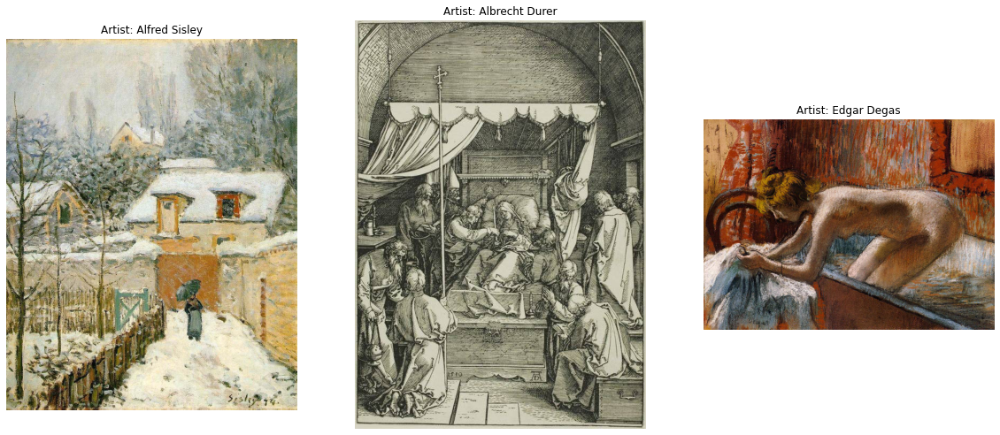

In [ ]:
random.seed(123)
fig, axes = plt.subplots(1, 3, figsize=(20,20))
for i in range(3):
  random_artist = random.choice(os.listdir("seg_train"))
  random_image = random.choice(os.listdir(os.path.join("seg_train", random_artist)))
  random_image_file = os.path.join("seg_train", random_artist, random_image)
  image = plt.imread(random_image_file)
  axes[i].imshow(image)
  axes[i].set_title("Artist: " + random_artist.replace('_', ' '))
  axes[i].axis('off')

plt.show()

# Data Analysis

#### Baseline Model

In [ ]:
#create tf.data.datasets for train and val sets
from tensorflow.keras.preprocessing import image_dataset_from_directory
train_dataset = image_dataset_from_directory(
    "seg_train",
    image_size=(150,150),
    batch_size=16
)

validation_dataset = image_dataset_from_directory(
    "seg_val",
    image_size=(150,150),
    batch_size=16
)

Found 2575 files belonging to 11 classes.
Found 865 files belonging to 11 classes.


In [ ]:
#create a baseline CNN model
def build_baseline(input_shape, filters):
  input = keras.Input(shape=input_shape)
  x = layers.experimental.preprocessing.Rescaling(1./255)(input)

  for filter in filters:
    x = layers.Conv2D(filters=filter, kernel_size=3, padding="same", use_bias=False)(x)
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)

  x = layers.GlobalAveragePooling2D()(x)
  output=layers.Dense(11, activation = "softmax")(x) #multiclass classification

  model = keras.Model(inputs=input, outputs=output)
  return model

baseline = build_baseline(input_shape = (150,150,3), filters=[16,32,64])
print(baseline.summary())

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 150, 150, 3)]     0         
                                                                 
 rescaling (Rescaling)       (None, 150, 150, 3)       0         
                                                                 
 conv2d (Conv2D)             (None, 150, 150, 16)      432       
                                                                 
 batch_normalization (BatchN  (None, 150, 150, 16)     64        
 ormalization)                                                   
                                                                 
 re_lu (ReLU)                (None, 150, 150, 16)      0         
                                                                 
 conv2d_1 (Conv2D)           (None, 150, 150, 32)      4608      
                                                             

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
#model compilation
lr_schedule = keras.optimizers.schedules.ExponentialDecay(
    initial_learning_rate=1e-3,
    decay_steps = 1000,
    decay_rate = 0.9
)

opt = tf.keras.optimizers.Adam(learning_rate = lr_schedule)

baseline.compile(
    loss = "sparse_categorical_crossentropy", 
    metrics=['accuracy'], 
    optimizer = opt)

early_stopping = tf.keras.callbacks.EarlyStopping(
    monitor = 'val_loss', 
    patience = 5, 
    min_delta=1e-4, 
    restore_best_weights = True)

checkpoint = keras.callbacks.ModelCheckpoint(
    filepath="drive/MyDrive/final_project/baseline_checkpoint", 
    save_best_only = True, 
    monitor = 'val_loss')

In [ ]:
history = baseline.fit(
    train_dataset,
    validation_data = validation_dataset,
    epochs = 50,
    verbose = 1,
    callbacks=[early_stopping, checkpoint]
)

Epoch 1/50
161/161 [==============================] - ETA: 0s - loss: 1.8313 - accuracy: 0.3565

161/161 [==============================] - 32s 140ms/step - loss: 1.8313 - accuracy: 0.3565 - val_loss: 2.4894 - val_accuracy: 0.1329
Epoch 2/50
161/161 [==============================] - ETA: 0s - loss: 1.6309 - accuracy: 0.4136

161/161 [==============================] - 21s 125ms/step - loss: 1.6309 - accuracy: 0.4136 - val_loss: 2.1292 - val_accuracy: 0.2566
Epoch 3/50
161/161 [==============================] - ETA: 0s - loss: 1.5634 - accuracy: 0.4450

161/161 [==============================] - 21s 124ms/step - loss: 1.5634 - accuracy: 0.4450 - val_loss: 1.6959 - val_accuracy: 0.4127
Epoch 4/50
161/161 [==============================] - ETA: 0s - loss: 1.5209 - accuracy: 0.4621

161/161 [==============================] - 22s 130ms/step - loss: 1.5209 - accuracy: 0.4621 - val_loss: 1.6775 - val_accuracy: 0.4370
Epoch 5/50
161/161 [==============================] - ETA: 0s - loss: 1.4904 - accuracy: 0.4691

161/161 [==============================] - 20s 123ms/step - loss: 1.4904 - accuracy: 0.4691 - val_loss: 1.6395 - val_accuracy: 0.4474
Epoch 6/50
161/161 [==============================] - ETA: 0s - loss: 1.4575 - accuracy: 0.4788

161/161 [==============================] - 21s 124ms/step - loss: 1.4575 - accuracy: 0.4788 - val_loss: 1.6245 - val_accuracy: 0.4486
Epoch 7/50
161/161 [==============================] - ETA: 0s - loss: 1.4435 - accuracy: 0.4901

161/161 [==============================] - 21s 126ms/step - loss: 1.4435 - accuracy: 0.4901 - val_loss: 1.5450 - val_accuracy: 0.4705
Epoch 8/50
161/161 [==============================] - 19s 115ms/step - loss: 1.4207 - accuracy: 0.4975 - val_loss: 1.7009 - val_accuracy: 0.4046
Epoch 9/50
161/161 [==============================] - 19s 115ms/step - loss: 1.4209 - accuracy: 0.4951 - val_loss: 1.6469 - val_accuracy: 0.4301
Epoch 10/50
161/161 [==============================] - ETA: 0s - loss: 1.3925 - accuracy: 0.5150

161/161 [==============================] - 20s 123ms/step - loss: 1.3925 - accuracy: 0.5150 - val_loss: 1.4538 - val_accuracy: 0.5017
Epoch 11/50
161/161 [==============================] - 19s 116ms/step - loss: 1.3727 - accuracy: 0.5103 - val_loss: 1.5770 - val_accuracy: 0.4532
Epoch 12/50
161/161 [==============================] - ETA: 0s - loss: 1.3726 - accuracy: 0.5060

161/161 [==============================] - 21s 124ms/step - loss: 1.3726 - accuracy: 0.5060 - val_loss: 1.4209 - val_accuracy: 0.5225
Epoch 13/50
161/161 [==============================] - 21s 128ms/step - loss: 1.3455 - accuracy: 0.5285 - val_loss: 1.4991 - val_accuracy: 0.4902
Epoch 14/50
161/161 [==============================] - 19s 116ms/step - loss: 1.3359 - accuracy: 0.5243 - val_loss: 1.4840 - val_accuracy: 0.4902
Epoch 15/50
161/161 [==============================] - 19s 117ms/step - loss: 1.3085 - accuracy: 0.5402 - val_loss: 1.4430 - val_accuracy: 0.5376
Epoch 16/50
161/161 [==============================] - 19s 116ms/step - loss: 1.2907 - accuracy: 0.5487 - val_loss: 1.5119 - val_accuracy: 0.4936
Epoch 17/50
161/161 [==============================] - ETA: 0s - loss: 1.2983 - accuracy: 0.5433

161/161 [==============================] - 22s 135ms/step - loss: 1.2983 - accuracy: 0.5433 - val_loss: 1.4180 - val_accuracy: 0.5225
Epoch 18/50
161/161 [==============================] - 20s 117ms/step - loss: 1.3072 - accuracy: 0.5480 - val_loss: 1.4913 - val_accuracy: 0.4948
Epoch 19/50
161/161 [==============================] - ETA: 0s - loss: 1.2852 - accuracy: 0.5581

161/161 [==============================] - 21s 127ms/step - loss: 1.2852 - accuracy: 0.5581 - val_loss: 1.3752 - val_accuracy: 0.5572
Epoch 20/50
161/161 [==============================] - 19s 117ms/step - loss: 1.2713 - accuracy: 0.5503 - val_loss: 1.5383 - val_accuracy: 0.4798
Epoch 21/50
161/161 [==============================] - 19s 116ms/step - loss: 1.2831 - accuracy: 0.5557 - val_loss: 1.4028 - val_accuracy: 0.5272
Epoch 22/50
161/161 [==============================] - 19s 116ms/step - loss: 1.2453 - accuracy: 0.5635 - val_loss: 1.4261 - val_accuracy: 0.5133
Epoch 23/50
161/161 [==============================] - ETA: 0s - loss: 1.2594 - accuracy: 0.5550

161/161 [==============================] - 22s 135ms/step - loss: 1.2594 - accuracy: 0.5550 - val_loss: 1.3159 - val_accuracy: 0.5642
Epoch 24/50
161/161 [==============================] - 20s 117ms/step - loss: 1.2383 - accuracy: 0.5709 - val_loss: 1.3881 - val_accuracy: 0.5329
Epoch 25/50
161/161 [==============================] - 19s 116ms/step - loss: 1.2262 - accuracy: 0.5674 - val_loss: 1.3265 - val_accuracy: 0.5618
Epoch 26/50
161/161 [==============================] - ETA: 0s - loss: 1.2181 - accuracy: 0.5755

161/161 [==============================] - 20s 123ms/step - loss: 1.2181 - accuracy: 0.5755 - val_loss: 1.3084 - val_accuracy: 0.5665
Epoch 27/50
161/161 [==============================] - 21s 126ms/step - loss: 1.2029 - accuracy: 0.5806 - val_loss: 1.3579 - val_accuracy: 0.5526
Epoch 28/50
161/161 [==============================] - 22s 130ms/step - loss: 1.2090 - accuracy: 0.5790 - val_loss: 1.3257 - val_accuracy: 0.5595
Epoch 29/50
161/161 [==============================] - 19s 115ms/step - loss: 1.2071 - accuracy: 0.5814 - val_loss: 1.3710 - val_accuracy: 0.5306
Epoch 30/50
161/161 [==============================] - 19s 115ms/step - loss: 1.2013 - accuracy: 0.5802 - val_loss: 1.3937 - val_accuracy: 0.5295
Epoch 31/50
161/161 [==============================] - 19s 116ms/step - loss: 1.1821 - accuracy: 0.5883 - val_loss: 1.4179 - val_accuracy: 0.5295


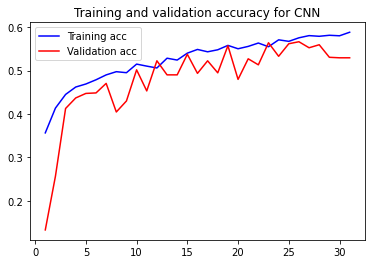

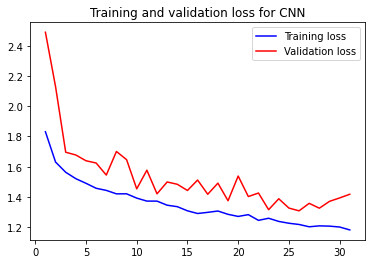

In [ ]:
#plot the learning curves
#getting train and validation accuracies
train_acc_CNN = history.history['accuracy']
val_acc_CNN = history.history['val_accuracy']

#getting train and validation losses
train_loss_CNN = history.history['loss']
val_loss_CNN = history.history['val_loss']
epochs = range(1, len(train_loss_CNN) + 1)

#plotting the training and validation accurracies
plt.plot(epochs, train_acc_CNN, 'b', label='Training acc')
plt.plot(epochs, val_acc_CNN, 'r', label='Validation acc')
plt.title('Training and validation accuracy for CNN')
plt.legend()
plt.figure()

#plotting the train and validaiton losses
plt.plot(epochs, train_loss_CNN, 'b', label='Training loss')
plt.plot(epochs, val_loss_CNN, 'r', label='Validation loss')
plt.title('Training and validation loss for CNN')
plt.legend()

plt.show()

The validation loss is consistently higher than the training loss. The validation accuracy sometimes peaks higher than the training accuracy but is till overall, lower than the training accuracy but still gets very close. At the end of training, the training accuracy reaches about 58% and the validation accuracy reaches about 55%, this is no better than random guessing. The training loss and training accuracy are decreasing and increasing respectfully. This model is overfitting for those reasons. 

#### Using Data Augmentation



In [ ]:
def data_augmentation(x):
  x = layers.experimental.preprocessing.RandomZoom(0.2)(x)
  x = layers.experimental.preprocessing.RandomFlip("horizontal")(x)
  return x

In [ ]:
#create a baseline CNN model
def build_baseline_with_aug(input_shape, filters):
  input = keras.Input(shape=input_shape)
  x = data_augmentation(input)
  x = layers.experimental.preprocessing.Rescaling(1./255)(x)

  for filter in filters:
    x = layers.Conv2D(filters=filter, kernel_size=3, padding="same", use_bias=False)(x)
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)

  x = layers.GlobalAveragePooling2D()(x)
  x = layers.Dropout(0.5)(x)
  output=layers.Dense(11, activation = "softmax")(x)

  model = keras.Model(inputs=input, outputs=output)
  return model

baseline_with_aug = build_baseline_with_aug(input_shape = (150,150,3), filters=[16,32, 64])
print(baseline.summary())

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 150, 150, 3)]     0         
                                                                 
 rescaling (Rescaling)       (None, 150, 150, 3)       0         
                                                                 
 conv2d (Conv2D)             (None, 150, 150, 16)      432       
                                                                 
 batch_normalization (BatchN  (None, 150, 150, 16)     64        
 ormalization)                                                   
                                                                 
 re_lu (ReLU)                (None, 150, 150, 16)      0         
                                                                 
 conv2d_1 (Conv2D)           (None, 150, 150, 32)      4608      
                                                             

In [ ]:
#compile
opt = tf.keras.optimizers.Adam(learning_rate = lr_schedule)

baseline_with_aug.compile(
    loss="sparse_categorical_crossentropy", 
    metrics = ['accuracy'], 
    optimizer=opt)

early_stopping = tf.keras.callbacks.EarlyStopping(
    monitor='val_loss', 
    patience = 10, 
    min_delta=1e-4, 
    restore_best_weights = True)

checkpoint = keras.callbacks.ModelCheckpoint(
    filepath = 'drive/MyDrive/final_project/baseline_with_aug_checkpoint', 
    save_best_only=True, 
    monitor='val_loss')

history = baseline_with_aug.fit(
    train_dataset,
    validation_data = validation_dataset,
    epochs = 100,
    verbose = 1,
    callbacks = [checkpoint]
)

Epoch 1/100
160/161 [============================>.] - ETA: 0s - loss: 2.0330 - accuracy: 0.2879

161/161 [==============================] - 26s 155ms/step - loss: 2.0323 - accuracy: 0.2885 - val_loss: 2.2177 - val_accuracy: 0.1977
Epoch 2/100
161/161 [==============================] - ETA: 0s - loss: 1.8518 - accuracy: 0.3359

161/161 [==============================] - 24s 147ms/step - loss: 1.8518 - accuracy: 0.3359 - val_loss: 2.0094 - val_accuracy: 0.2786
Epoch 3/100
161/161 [==============================] - ETA: 0s - loss: 1.8049 - accuracy: 0.3553

161/161 [==============================] - 23s 139ms/step - loss: 1.8049 - accuracy: 0.3553 - val_loss: 1.7213 - val_accuracy: 0.4405
Epoch 4/100
160/161 [============================>.] - ETA: 0s - loss: 1.7297 - accuracy: 0.3848

161/161 [==============================] - 24s 146ms/step - loss: 1.7303 - accuracy: 0.3829 - val_loss: 1.6247 - val_accuracy: 0.4416
Epoch 5/100
161/161 [==============================] - 21s 125ms/step - loss: 1.6865 - accuracy: 0.3988 - val_loss: 1.7020 - val_accuracy: 0.4208
Epoch 6/100
161/161 [==============================] - 21s 124ms/step - loss: 1.7085 - accuracy: 0.3891 - val_loss: 1.8812 - val_accuracy: 0.3630
Epoch 7/100
161/161 [==============================] - 21s 124ms/step - loss: 1.6588 - accuracy: 0.4070 - val_loss: 1.8017 - val_accuracy: 0.3746
Epoch 8/100
161/161 [==============================] - 21s 124ms/step - loss: 1.6530 - accuracy: 0.4070 - val_loss: 1.7291 - val_accuracy: 0.4081
Epoch 9/100
161/161 [==============================] - 21s 124ms/step - loss: 1.6193 - accuracy: 0.4210 - val_loss: 1.8744 - val_accuracy: 0.3699
Epoch 10/100
161/161 [==============================] - 22s 136ms/step - loss: 1.6204 - accuracy: 0.4206 - val_loss: 1.6674 - val_accura

161/161 [==============================] - 23s 137ms/step - loss: 1.6289 - accuracy: 0.4206 - val_loss: 1.5867 - val_accuracy: 0.4682
Epoch 12/100
161/161 [==============================] - 21s 125ms/step - loss: 1.6041 - accuracy: 0.4384 - val_loss: 1.7400 - val_accuracy: 0.3954
Epoch 13/100
161/161 [==============================] - 21s 124ms/step - loss: 1.5903 - accuracy: 0.4365 - val_loss: 1.6882 - val_accuracy: 0.4462
Epoch 14/100
161/161 [==============================] - ETA: 0s - loss: 1.5927 - accuracy: 0.4357

161/161 [==============================] - 23s 139ms/step - loss: 1.5927 - accuracy: 0.4357 - val_loss: 1.5619 - val_accuracy: 0.4682
Epoch 15/100
161/161 [==============================] - 23s 137ms/step - loss: 1.5891 - accuracy: 0.4532 - val_loss: 1.9514 - val_accuracy: 0.3503
Epoch 16/100
161/161 [==============================] - 20s 123ms/step - loss: 1.5507 - accuracy: 0.4513 - val_loss: 1.5976 - val_accuracy: 0.4786
Epoch 17/100
161/161 [==============================] - 22s 135ms/step - loss: 1.5783 - accuracy: 0.4318 - val_loss: 1.6183 - val_accuracy: 0.4671
Epoch 18/100
161/161 [==============================] - 21s 125ms/step - loss: 1.5731 - accuracy: 0.4470 - val_loss: 1.6413 - val_accuracy: 0.4486
Epoch 19/100
161/161 [==============================] - 21s 124ms/step - loss: 1.5407 - accuracy: 0.4493 - val_loss: 1.6366 - val_accuracy: 0.4301
Epoch 20/100
161/161 [==============================] - 21s 125ms/step - loss: 1.5299 - accuracy: 0.4660 - val_loss: 1.8282 - val_a

161/161 [==============================] - 23s 139ms/step - loss: 1.5416 - accuracy: 0.4517 - val_loss: 1.5155 - val_accuracy: 0.4821
Epoch 22/100
161/161 [==============================] - 22s 135ms/step - loss: 1.5130 - accuracy: 0.4625 - val_loss: 1.5701 - val_accuracy: 0.4855
Epoch 23/100
161/161 [==============================] - 21s 125ms/step - loss: 1.5322 - accuracy: 0.4571 - val_loss: 1.5355 - val_accuracy: 0.4913
Epoch 24/100
161/161 [==============================] - 21s 129ms/step - loss: 1.5044 - accuracy: 0.4583 - val_loss: 1.5375 - val_accuracy: 0.4867
Epoch 25/100
161/161 [==============================] - 21s 124ms/step - loss: 1.5133 - accuracy: 0.4676 - val_loss: 1.5229 - val_accuracy: 0.4867
Epoch 26/100
161/161 [==============================] - 21s 125ms/step - loss: 1.5229 - accuracy: 0.4520 - val_loss: 1.5241 - val_accuracy: 0.5191
Epoch 27/100
161/161 [==============================] - 21s 124ms/step - loss: 1.5076 - accuracy: 0.4645 - val_loss: 1.6004 - val_a

161/161 [==============================] - 23s 139ms/step - loss: 1.4947 - accuracy: 0.4652 - val_loss: 1.5000 - val_accuracy: 0.5075
Epoch 32/100
161/161 [==============================] - 22s 136ms/step - loss: 1.4940 - accuracy: 0.4769 - val_loss: 1.5346 - val_accuracy: 0.5052
Epoch 33/100
161/161 [==============================] - 21s 125ms/step - loss: 1.5035 - accuracy: 0.4649 - val_loss: 1.6059 - val_accuracy: 0.4439
Epoch 34/100
161/161 [==============================] - 21s 125ms/step - loss: 1.4786 - accuracy: 0.4850 - val_loss: 1.5429 - val_accuracy: 0.4936
Epoch 35/100
161/161 [==============================] - 21s 125ms/step - loss: 1.4664 - accuracy: 0.4905 - val_loss: 1.5453 - val_accuracy: 0.4832
Epoch 36/100
161/161 [==============================] - 21s 124ms/step - loss: 1.4637 - accuracy: 0.4804 - val_loss: 1.5342 - val_accuracy: 0.5052
Epoch 37/100
161/161 [==============================] - ETA: 0s - loss: 1.4768 - accuracy: 0.4730

161/161 [==============================] - 23s 136ms/step - loss: 1.4768 - accuracy: 0.4730 - val_loss: 1.4817 - val_accuracy: 0.5237
Epoch 38/100
161/161 [==============================] - 23s 136ms/step - loss: 1.4803 - accuracy: 0.4781 - val_loss: 1.5558 - val_accuracy: 0.4844
Epoch 39/100
161/161 [==============================] - 21s 126ms/step - loss: 1.4739 - accuracy: 0.4788 - val_loss: 1.5876 - val_accuracy: 0.4728
Epoch 40/100
161/161 [==============================] - 22s 135ms/step - loss: 1.4525 - accuracy: 0.4951 - val_loss: 1.7631 - val_accuracy: 0.4543
Epoch 41/100
161/161 [==============================] - 21s 124ms/step - loss: 1.4691 - accuracy: 0.4847 - val_loss: 1.5313 - val_accuracy: 0.4948
Epoch 42/100
161/161 [==============================] - 21s 125ms/step - loss: 1.4669 - accuracy: 0.4827 - val_loss: 1.5340 - val_accuracy: 0.4798
Epoch 43/100
161/161 [==============================] - 21s 125ms/step - loss: 1.4549 - accuracy: 0.4792 - val_loss: 1.6249 - val_a

161/161 [==============================] - 22s 136ms/step - loss: 1.4463 - accuracy: 0.4882 - val_loss: 1.4800 - val_accuracy: 0.5168
Epoch 49/100
161/161 [==============================] - 21s 127ms/step - loss: 1.4393 - accuracy: 0.4917 - val_loss: 1.7013 - val_accuracy: 0.4486
Epoch 50/100
161/161 [==============================] - 21s 126ms/step - loss: 1.4515 - accuracy: 0.4889 - val_loss: 1.5256 - val_accuracy: 0.5168
Epoch 51/100
161/161 [==============================] - 21s 127ms/step - loss: 1.4584 - accuracy: 0.4920 - val_loss: 1.6919 - val_accuracy: 0.4566
Epoch 52/100
161/161 [==============================] - 23s 138ms/step - loss: 1.4329 - accuracy: 0.4917 - val_loss: 1.5384 - val_accuracy: 0.5110
Epoch 53/100
161/161 [==============================] - ETA: 0s - loss: 1.4134 - accuracy: 0.5021

161/161 [==============================] - 23s 139ms/step - loss: 1.4134 - accuracy: 0.5021 - val_loss: 1.4778 - val_accuracy: 0.5168
Epoch 54/100
161/161 [==============================] - 21s 125ms/step - loss: 1.4450 - accuracy: 0.4905 - val_loss: 1.5451 - val_accuracy: 0.4971
Epoch 55/100
161/161 [==============================] - 21s 127ms/step - loss: 1.4356 - accuracy: 0.4917 - val_loss: 1.6545 - val_accuracy: 0.4613
Epoch 56/100
161/161 [==============================] - 21s 126ms/step - loss: 1.4071 - accuracy: 0.4994 - val_loss: 1.7325 - val_accuracy: 0.4601
Epoch 57/100
161/161 [==============================] - 21s 127ms/step - loss: 1.4236 - accuracy: 0.4955 - val_loss: 1.6204 - val_accuracy: 0.4740
Epoch 58/100
161/161 [==============================] - 23s 137ms/step - loss: 1.4229 - accuracy: 0.5072 - val_loss: 1.4919 - val_accuracy: 0.5191
Epoch 59/100
161/161 [==============================] - 21s 126ms/step - loss: 1.4128 - accuracy: 0.5103 - val_loss: 1.4991 - val_a

161/161 [==============================] - 23s 139ms/step - loss: 1.4078 - accuracy: 0.5060 - val_loss: 1.4646 - val_accuracy: 0.5110
Epoch 65/100
161/161 [==============================] - 23s 139ms/step - loss: 1.4121 - accuracy: 0.5052 - val_loss: 1.4866 - val_accuracy: 0.5110
Epoch 66/100
161/161 [==============================] - 21s 127ms/step - loss: 1.4040 - accuracy: 0.4951 - val_loss: 1.5321 - val_accuracy: 0.5110
Epoch 67/100
161/161 [==============================] - 21s 128ms/step - loss: 1.4267 - accuracy: 0.5006 - val_loss: 1.5674 - val_accuracy: 0.4855
Epoch 68/100
161/161 [==============================] - 21s 128ms/step - loss: 1.4038 - accuracy: 0.5068 - val_loss: 1.5151 - val_accuracy: 0.5040
Epoch 69/100
161/161 [==============================] - 21s 127ms/step - loss: 1.4122 - accuracy: 0.5076 - val_loss: 1.6810 - val_accuracy: 0.4578
Epoch 70/100
161/161 [==============================] - 21s 130ms/step - loss: 1.4239 - accuracy: 0.4963 - val_loss: 1.5860 - val_a

161/161 [==============================] - 23s 141ms/step - loss: 1.3833 - accuracy: 0.5115 - val_loss: 1.4542 - val_accuracy: 0.5318
Epoch 76/100
161/161 [==============================] - 21s 129ms/step - loss: 1.3959 - accuracy: 0.5029 - val_loss: 1.6145 - val_accuracy: 0.4775
Epoch 77/100
161/161 [==============================] - 25s 152ms/step - loss: 1.3906 - accuracy: 0.5072 - val_loss: 1.5185 - val_accuracy: 0.5040
Epoch 78/100
161/161 [==============================] - 21s 129ms/step - loss: 1.3710 - accuracy: 0.5142 - val_loss: 1.6453 - val_accuracy: 0.4809
Epoch 79/100
161/161 [==============================] - 21s 128ms/step - loss: 1.4034 - accuracy: 0.5017 - val_loss: 1.4693 - val_accuracy: 0.5168
Epoch 80/100
161/161 [==============================] - 21s 128ms/step - loss: 1.3961 - accuracy: 0.5184 - val_loss: 1.7188 - val_accuracy: 0.4543
Epoch 81/100
160/161 [============================>.] - ETA: 0s - loss: 1.4113 - accuracy: 0.5121

161/161 [==============================] - 23s 142ms/step - loss: 1.4098 - accuracy: 0.5118 - val_loss: 1.4375 - val_accuracy: 0.5191
Epoch 82/100
161/161 [==============================] - 21s 126ms/step - loss: 1.3777 - accuracy: 0.5212 - val_loss: 1.4465 - val_accuracy: 0.5272
Epoch 83/100
161/161 [==============================] - 21s 127ms/step - loss: 1.3860 - accuracy: 0.5083 - val_loss: 1.5440 - val_accuracy: 0.5064
Epoch 84/100
161/161 [==============================] - 21s 127ms/step - loss: 1.3705 - accuracy: 0.5161 - val_loss: 1.4558 - val_accuracy: 0.5121
Epoch 85/100
161/161 [==============================] - 21s 128ms/step - loss: 1.3914 - accuracy: 0.5091 - val_loss: 1.5008 - val_accuracy: 0.5098
Epoch 86/100
161/161 [==============================] - 25s 150ms/step - loss: 1.3862 - accuracy: 0.5142 - val_loss: 1.6931 - val_accuracy: 0.4555
Epoch 87/100
161/161 [==============================] - 21s 128ms/step - loss: 1.3931 - accuracy: 0.5258 - val_loss: 1.5199 - val_a

161/161 [==============================] - 23s 140ms/step - loss: 1.3619 - accuracy: 0.5274 - val_loss: 1.4312 - val_accuracy: 0.5318


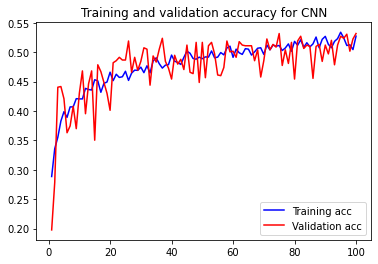

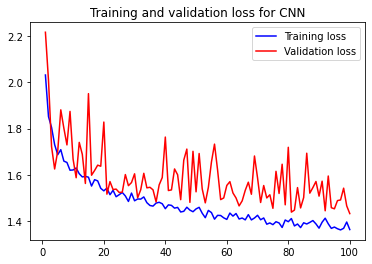

In [ ]:
#getting train and validation accuracies
train_acc_CNN = history.history['accuracy']
val_acc_CNN = history.history['val_accuracy']

#getting train and validation losses
train_loss_CNN = history.history['loss']
val_loss_CNN = history.history['val_loss']
epochs = range(1, len(train_loss_CNN) + 1)

#plotting the training and validation accurracies
plt.plot(epochs, train_acc_CNN, 'b', label='Training acc')
plt.plot(epochs, val_acc_CNN, 'r', label='Validation acc')
plt.title('Training and validation accuracy for CNN')
plt.legend()
plt.figure()

#plotting the train and validaiton losses
plt.plot(epochs, train_loss_CNN, 'b', label='Training loss')
plt.plot(epochs, val_loss_CNN, 'r', label='Validation loss')
plt.title('Training and validation loss for CNN')
plt.legend()

plt.show()

Validation loss is still consistently higher than training loss and validation accuracy is still consistently lower except for the occassional peak. This model is still overfitting and does no better than random guessing.

#### With Residual Connections and Depth Wise Separable Convolutions

In [ ]:
#residual block
def residual_block(x, filter):
  residual = x
  x = layers.SeparableConv2D(filters=filter, kernel_size=3, padding="same", use_bias=False)(x)
  x = layers.BatchNormalization()(x)
  x = layers.ReLU()(x)

  x = layers.SeparableConv2D(filters=filter, kernel_size=3, padding="same", use_bias=False)(x)
  x = layers.BatchNormalization()(x)
  x = layers.ReLU()(x)

  x = layers.MaxPooling2D(pool_size=2, padding="same")(x)

  residual = layers.Conv2D(filters=filter, kernel_size=1, strides=2, use_bias=False)(residual)
  residual= layers.BatchNormalization()(residual)

  x = layers.add([x, residual])
  return x

In [ ]:
#create a baseline CNN model
def build_baseline_with_resaug(input_shape, filters):
  input = keras.Input(shape=input_shape)
  x = data_augmentation(input)
  x = layers.experimental.preprocessing.Rescaling(1./255)(x)

  for filter in filters:
    x = residual_block(x, filter)

  x = layers.GlobalAveragePooling2D()(x)
  x = layers.Dropout(0.5)(x)
  output=layers.Dense(11, activation = "softmax")(x)

  model = keras.Model(inputs=input, outputs=output)
  return model

baseline_with_resaug = build_baseline_with_resaug(input_shape = (150,150,3), filters=[16,32,64])
print(baseline_with_resaug.summary())

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, 150, 150, 3  0           []                               
                                )]                                                                
                                                                                                  
 random_zoom_1 (RandomZoom)     (None, 150, 150, 3)  0           ['input_3[0][0]']                
                                                                                                  
 random_flip_1 (RandomFlip)     (None, 150, 150, 3)  0           ['random_zoom_1[0][0]']          
                                                                                                  
 rescaling_2 (Rescaling)        (None, 150, 150, 3)  0           ['random_flip_1[0][0]']    

In [ ]:
#compile
opt = tf.keras.optimizers.Adam(learning_rate = lr_schedule)

baseline_with_resaug.compile(
    loss="sparse_categorical_crossentropy", 
    metrics = ['accuracy'], 
    optimizer=opt)

early_stopping = tf.keras.callbacks.EarlyStopping(
    monitor='val_loss', 
    patience = 10, 
    min_delta=1e-4, 
    restore_best_weights = True)

checkpoint = keras.callbacks.ModelCheckpoint(
    filepath = 'drive/MyDrive/final_project/baseline_with_resaug_checkpoint', 
    save_best_only=True, 
    monitor='val_loss')

history = baseline_with_resaug.fit(
    train_dataset,
    validation_data = validation_dataset,
    epochs = 100,
    verbose = 1,
    callbacks = [checkpoint]
)

Epoch 1/100
161/161 [==============================] - ETA: 0s - loss: 2.2087 - accuracy: 0.2629

161/161 [==============================] - 32s 183ms/step - loss: 2.2087 - accuracy: 0.2629 - val_loss: 2.5175 - val_accuracy: 0.0821
Epoch 2/100
161/161 [==============================] - ETA: 0s - loss: 1.8749 - accuracy: 0.3515

161/161 [==============================] - 28s 170ms/step - loss: 1.8749 - accuracy: 0.3515 - val_loss: 2.4724 - val_accuracy: 0.1908
Epoch 3/100
161/161 [==============================] - ETA: 0s - loss: 1.7830 - accuracy: 0.3616

161/161 [==============================] - 28s 169ms/step - loss: 1.7830 - accuracy: 0.3616 - val_loss: 2.0444 - val_accuracy: 0.2971
Epoch 4/100
161/161 [==============================] - ETA: 0s - loss: 1.7407 - accuracy: 0.3911

161/161 [==============================] - 28s 167ms/step - loss: 1.7407 - accuracy: 0.3911 - val_loss: 1.6102 - val_accuracy: 0.4578
Epoch 5/100
161/161 [==============================] - 23s 139ms/step - loss: 1.6800 - accuracy: 0.4128 - val_loss: 1.6571 - val_accuracy: 0.4497
Epoch 6/100
161/161 [==============================] - 23s 139ms/step - loss: 1.6241 - accuracy: 0.4214 - val_loss: 1.8310 - val_accuracy: 0.4173
Epoch 7/100
161/161 [==============================] - 23s 140ms/step - loss: 1.5696 - accuracy: 0.4482 - val_loss: 2.0549 - val_accuracy: 0.3942
Epoch 8/100
161/161 [==============================] - 23s 139ms/step - loss: 1.5657 - accuracy: 0.4563 - val_loss: 1.9684 - val_accuracy: 0.4000
Epoch 9/100
161/161 [==============================] - ETA: 0s - loss: 1.5182 - accuracy: 0.4707

161/161 [==============================] - 28s 167ms/step - loss: 1.5182 - accuracy: 0.4707 - val_loss: 1.5269 - val_accuracy: 0.5098
Epoch 10/100
161/161 [==============================] - 23s 141ms/step - loss: 1.5227 - accuracy: 0.4629 - val_loss: 2.0454 - val_accuracy: 0.3827
Epoch 11/100
161/161 [==============================] - 23s 141ms/step - loss: 1.4931 - accuracy: 0.4676 - val_loss: 1.8011 - val_accuracy: 0.4428
Epoch 12/100
161/161 [==============================] - 24s 142ms/step - loss: 1.4724 - accuracy: 0.4932 - val_loss: 1.8421 - val_accuracy: 0.4358
Epoch 13/100
161/161 [==============================] - 23s 141ms/step - loss: 1.4370 - accuracy: 0.4913 - val_loss: 1.8501 - val_accuracy: 0.4416
Epoch 14/100
161/161 [==============================] - 27s 162ms/step - loss: 1.4242 - accuracy: 0.5006 - val_loss: 1.5527 - val_accuracy: 0.4867
Epoch 15/100
161/161 [==============================] - 24s 143ms/step - loss: 1.4030 - accuracy: 0.5080 - val_loss: 1.5922 - val_a

161/161 [==============================] - 28s 169ms/step - loss: 1.4170 - accuracy: 0.5056 - val_loss: 1.5074 - val_accuracy: 0.5249
Epoch 19/100
161/161 [==============================] - ETA: 0s - loss: 1.3515 - accuracy: 0.5297

161/161 [==============================] - 28s 170ms/step - loss: 1.3515 - accuracy: 0.5297 - val_loss: 1.4525 - val_accuracy: 0.5064
Epoch 20/100
161/161 [==============================] - ETA: 0s - loss: 1.3626 - accuracy: 0.5313

161/161 [==============================] - 28s 167ms/step - loss: 1.3626 - accuracy: 0.5313 - val_loss: 1.3772 - val_accuracy: 0.5538
Epoch 21/100
161/161 [==============================] - 23s 139ms/step - loss: 1.3622 - accuracy: 0.5212 - val_loss: 1.5054 - val_accuracy: 0.5353
Epoch 22/100
161/161 [==============================] - ETA: 0s - loss: 1.3544 - accuracy: 0.5200

161/161 [==============================] - 29s 173ms/step - loss: 1.3544 - accuracy: 0.5200 - val_loss: 1.3624 - val_accuracy: 0.5514
Epoch 23/100
161/161 [==============================] - 23s 141ms/step - loss: 1.3205 - accuracy: 0.5317 - val_loss: 1.4149 - val_accuracy: 0.5410
Epoch 24/100
161/161 [==============================] - 23s 139ms/step - loss: 1.3148 - accuracy: 0.5421 - val_loss: 1.3840 - val_accuracy: 0.5514
Epoch 25/100
161/161 [==============================] - 23s 141ms/step - loss: 1.3214 - accuracy: 0.5414 - val_loss: 1.4413 - val_accuracy: 0.5341
Epoch 26/100
161/161 [==============================] - 23s 139ms/step - loss: 1.2855 - accuracy: 0.5515 - val_loss: 1.6437 - val_accuracy: 0.4809
Epoch 27/100
161/161 [==============================] - 23s 140ms/step - loss: 1.2950 - accuracy: 0.5584 - val_loss: 1.4237 - val_accuracy: 0.5387
Epoch 28/100
161/161 [==============================] - 23s 141ms/step - loss: 1.2817 - accuracy: 0.5546 - val_loss: 1.3871 - val_a

161/161 [==============================] - 27s 165ms/step - loss: 1.2004 - accuracy: 0.5872 - val_loss: 1.3111 - val_accuracy: 0.5757
Epoch 38/100
161/161 [==============================] - ETA: 0s - loss: 1.2124 - accuracy: 0.5670

161/161 [==============================] - 28s 169ms/step - loss: 1.2124 - accuracy: 0.5670 - val_loss: 1.2694 - val_accuracy: 0.5757
Epoch 39/100
161/161 [==============================] - 23s 141ms/step - loss: 1.2216 - accuracy: 0.5783 - val_loss: 1.3357 - val_accuracy: 0.5549
Epoch 40/100
161/161 [==============================] - 23s 140ms/step - loss: 1.2192 - accuracy: 0.5736 - val_loss: 1.4564 - val_accuracy: 0.5399
Epoch 41/100
161/161 [==============================] - 23s 140ms/step - loss: 1.1881 - accuracy: 0.5899 - val_loss: 1.3209 - val_accuracy: 0.5850
Epoch 42/100
161/161 [==============================] - 24s 146ms/step - loss: 1.1758 - accuracy: 0.5903 - val_loss: 1.3623 - val_accuracy: 0.5387
Epoch 43/100
161/161 [==============================] - 26s 151ms/step - loss: 1.1546 - accuracy: 0.6078 - val_loss: 1.4139 - val_accuracy: 0.5457
Epoch 44/100
161/161 [==============================] - 23s 138ms/step - loss: 1.1792 - accuracy: 0.5891 - val_loss: 1.2936 - val_a

161/161 [==============================] - 28s 169ms/step - loss: 1.1380 - accuracy: 0.6089 - val_loss: 1.2104 - val_accuracy: 0.5896
Epoch 54/100
161/161 [==============================] - 23s 141ms/step - loss: 1.1224 - accuracy: 0.6085 - val_loss: 1.2875 - val_accuracy: 0.5815
Epoch 55/100
161/161 [==============================] - 24s 142ms/step - loss: 1.0851 - accuracy: 0.6144 - val_loss: 1.4311 - val_accuracy: 0.5607
Epoch 56/100
161/161 [==============================] - 24s 143ms/step - loss: 1.1349 - accuracy: 0.6144 - val_loss: 1.3469 - val_accuracy: 0.5595
Epoch 57/100
161/161 [==============================] - 23s 140ms/step - loss: 1.1154 - accuracy: 0.6221 - val_loss: 1.3255 - val_accuracy: 0.5699
Epoch 58/100
161/161 [==============================] - 24s 142ms/step - loss: 1.0930 - accuracy: 0.6233 - val_loss: 1.4251 - val_accuracy: 0.5734
Epoch 59/100
161/161 [==============================] - ETA: 0s - loss: 1.1214 - accuracy: 0.6074

161/161 [==============================] - 28s 170ms/step - loss: 1.1214 - accuracy: 0.6074 - val_loss: 1.2063 - val_accuracy: 0.6150
Epoch 60/100
161/161 [==============================] - 24s 142ms/step - loss: 1.0721 - accuracy: 0.6245 - val_loss: 1.3716 - val_accuracy: 0.5699
Epoch 61/100
161/161 [==============================] - 23s 140ms/step - loss: 1.0947 - accuracy: 0.6245 - val_loss: 1.2192 - val_accuracy: 0.6289
Epoch 62/100
161/161 [==============================] - 26s 157ms/step - loss: 1.0655 - accuracy: 0.6291 - val_loss: 1.2875 - val_accuracy: 0.5988
Epoch 63/100
161/161 [==============================] - 23s 138ms/step - loss: 1.0764 - accuracy: 0.6237 - val_loss: 1.2204 - val_accuracy: 0.6254
Epoch 64/100
161/161 [==============================] - 23s 141ms/step - loss: 1.0767 - accuracy: 0.6217 - val_loss: 1.2502 - val_accuracy: 0.5965
Epoch 65/100
161/161 [==============================] - 23s 141ms/step - loss: 1.0790 - accuracy: 0.6260 - val_loss: 1.2474 - val_a

161/161 [==============================] - 27s 166ms/step - loss: 1.0620 - accuracy: 0.6307 - val_loss: 1.1403 - val_accuracy: 0.6393
Epoch 71/100
161/161 [==============================] - 26s 160ms/step - loss: 1.0381 - accuracy: 0.6404 - val_loss: 1.2163 - val_accuracy: 0.6081
Epoch 72/100
161/161 [==============================] - 23s 140ms/step - loss: 1.0714 - accuracy: 0.6315 - val_loss: 1.2070 - val_accuracy: 0.6208
Epoch 73/100
161/161 [==============================] - 23s 139ms/step - loss: 1.0443 - accuracy: 0.6447 - val_loss: 1.2432 - val_accuracy: 0.5988
Epoch 74/100
161/161 [==============================] - 23s 140ms/step - loss: 1.0483 - accuracy: 0.6396 - val_loss: 1.2559 - val_accuracy: 0.6069
Epoch 75/100
161/161 [==============================] - 23s 141ms/step - loss: 1.0543 - accuracy: 0.6342 - val_loss: 1.2297 - val_accuracy: 0.5965
Epoch 76/100
161/161 [==============================] - 23s 140ms/step - loss: 1.0176 - accuracy: 0.6458 - val_loss: 1.3149 - val_a

161/161 [==============================] - 27s 165ms/step - loss: 0.9962 - accuracy: 0.6482 - val_loss: 1.1083 - val_accuracy: 0.6393
Epoch 86/100
161/161 [==============================] - 23s 140ms/step - loss: 1.0295 - accuracy: 0.6416 - val_loss: 1.1199 - val_accuracy: 0.6312
Epoch 87/100
161/161 [==============================] - 23s 141ms/step - loss: 1.0037 - accuracy: 0.6606 - val_loss: 1.1753 - val_accuracy: 0.6277
Epoch 88/100
161/161 [==============================] - 23s 139ms/step - loss: 1.0203 - accuracy: 0.6528 - val_loss: 1.1789 - val_accuracy: 0.6220
Epoch 89/100
161/161 [==============================] - 23s 142ms/step - loss: 1.0145 - accuracy: 0.6602 - val_loss: 1.2057 - val_accuracy: 0.6092
Epoch 90/100
161/161 [==============================] - 23s 138ms/step - loss: 1.0137 - accuracy: 0.6513 - val_loss: 1.2121 - val_accuracy: 0.6058
Epoch 91/100
161/161 [==============================] - 23s 139ms/step - loss: 0.9990 - accuracy: 0.6524 - val_loss: 1.2000 - val_a

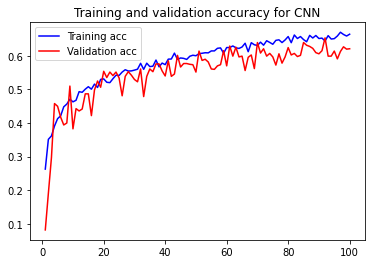

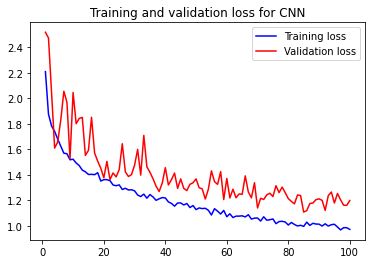

In [ ]:
#getting train and validation accuracies
train_acc_CNN = history.history['accuracy']
val_acc_CNN = history.history['val_accuracy']

#getting train and validation losses
train_loss_CNN = history.history['loss']
val_loss_CNN = history.history['val_loss']
epochs = range(1, len(train_loss_CNN) + 1)

#plotting the training and validation accurracies
plt.plot(epochs, train_acc_CNN, 'b', label='Training acc')
plt.plot(epochs, val_acc_CNN, 'r', label='Validation acc')
plt.title('Training and validation accuracy for CNN')
plt.legend()
plt.figure()

#plotting the train and validaiton losses
plt.plot(epochs, train_loss_CNN, 'b', label='Training loss')
plt.plot(epochs, val_loss_CNN, 'r', label='Validation loss')
plt.title('Training and validation loss for CNN')
plt.legend()

plt.show()

validation loss is still higher than training loss, but validation accuracy seems closer to training accuracy and is higher overall with 66% training accuracy and 62% val accuracy. This model is a little bit better but still overfitting. 

#### Balancing the data using undersampling

In [ ]:
#create a directory to hold extra images from degas and van gogh
os.mkdir('extra_images')

parent_dir = "extra_images"

extra_images_Edgar_Degas = os.path.join(parent_dir, "Edgar_Degas")
os.mkdir(extra_images_Edgar_Degas)

extra_images_Vincent_van_Gogh = os.path.join(parent_dir, "Vincent_van_Gogh")
os.mkdir(extra_images_Vincent_van_Gogh)

os.listdir("extra_images")

['Vincent_van_Gogh', 'Edgar_Degas']

In [ ]:
#move 200 images from edgar degas train data
dataset_directory = "seg_train/Edgar_Degas"
degas_files = os.listdir(dataset_directory)
for i in range(200):
  src = os.path.join(dataset_directory, degas_files[i])
  dst = os.path.join(extra_images_Edgar_Degas, degas_files[i])
  shutil.move(src, dst)
print(len(os.listdir("extra_images/Edgar_Degas")))

200


In [ ]:
#move 300 images from van gogh train data
dataset_directory = "seg_train/Vincent_van_Gogh"
vangogh_files = os.listdir(dataset_directory)
for i in range(300):
  src = os.path.join(dataset_directory, vangogh_files[i])
  dst = os.path.join(extra_images_Vincent_van_Gogh, vangogh_files[i])
  shutil.move(src, dst)
print(len(os.listdir("extra_images/Vincent_van_Gogh")))

300


In [ ]:
#turn the new training dataset into tensor
u_train_dataset = image_dataset_from_directory(
    "seg_train",
    image_size=(150,150),
    batch_size=16
)

Found 2075 files belonging to 11 classes.


In [ ]:
#train the resaug model with the new training data

checkpoint = keras.callbacks.ModelCheckpoint(
    filepath = 'drive/MyDrive/final_project/baseline_with_resaug_undersampled_checkpoint', 
    save_best_only=True, 
    monitor='val_loss')

history = baseline_with_resaug.fit(
    u_train_dataset,
    validation_data = validation_dataset,
    epochs = 100,
    verbose = 1,
    callbacks = [checkpoint]
)

Epoch 1/100
130/130 [==============================] - ETA: 0s - loss: 0.9973 - accuracy: 0.6569

130/130 [==============================] - 25s 186ms/step - loss: 0.9973 - accuracy: 0.6569 - val_loss: 1.0285 - val_accuracy: 0.6451
Epoch 2/100
130/130 [==============================] - ETA: 0s - loss: 0.9614 - accuracy: 0.6723

130/130 [==============================] - 24s 182ms/step - loss: 0.9614 - accuracy: 0.6723 - val_loss: 0.9955 - val_accuracy: 0.6462
Epoch 3/100
130/130 [==============================] - ETA: 0s - loss: 0.9810 - accuracy: 0.6723

130/130 [==============================] - 24s 183ms/step - loss: 0.9810 - accuracy: 0.6723 - val_loss: 0.9604 - val_accuracy: 0.6890
Epoch 4/100
130/130 [==============================] - 20s 148ms/step - loss: 0.9943 - accuracy: 0.6708 - val_loss: 0.9768 - val_accuracy: 0.6751
Epoch 5/100
130/130 [==============================] - 20s 149ms/step - loss: 0.9786 - accuracy: 0.6631 - val_loss: 0.9915 - val_accuracy: 0.6659
Epoch 6/100
130/130 [==============================] - 20s 147ms/step - loss: 0.9857 - accuracy: 0.6723 - val_loss: 0.9636 - val_accuracy: 0.6751
Epoch 7/100
130/130 [==============================] - 20s 147ms/step - loss: 0.9529 - accuracy: 0.6800 - val_loss: 1.0151 - val_accuracy: 0.6659
Epoch 8/100
130/130 [==============================] - ETA: 0s - loss: 0.9829 - accuracy: 0.6622

130/130 [==============================] - 24s 181ms/step - loss: 0.9829 - accuracy: 0.6622 - val_loss: 0.9579 - val_accuracy: 0.6925
Epoch 9/100
130/130 [==============================] - 20s 149ms/step - loss: 0.9470 - accuracy: 0.6805 - val_loss: 1.0348 - val_accuracy: 0.6555
Epoch 10/100
130/130 [==============================] - 23s 171ms/step - loss: 0.9499 - accuracy: 0.6867 - val_loss: 1.0361 - val_accuracy: 0.6451
Epoch 11/100
130/130 [==============================] - 20s 151ms/step - loss: 0.9499 - accuracy: 0.6786 - val_loss: 0.9758 - val_accuracy: 0.6751
Epoch 12/100
130/130 [==============================] - 20s 150ms/step - loss: 0.9456 - accuracy: 0.6781 - val_loss: 0.9842 - val_accuracy: 0.6636
Epoch 13/100
130/130 [==============================] - ETA: 0s - loss: 0.9451 - accuracy: 0.6839

130/130 [==============================] - 24s 183ms/step - loss: 0.9451 - accuracy: 0.6839 - val_loss: 0.9551 - val_accuracy: 0.6948
Epoch 14/100
130/130 [==============================] - 20s 149ms/step - loss: 0.9731 - accuracy: 0.6737 - val_loss: 0.9939 - val_accuracy: 0.6671
Epoch 15/100
130/130 [==============================] - 20s 148ms/step - loss: 0.9537 - accuracy: 0.6641 - val_loss: 1.0018 - val_accuracy: 0.6578
Epoch 16/100
130/130 [==============================] - 21s 155ms/step - loss: 0.9501 - accuracy: 0.6877 - val_loss: 0.9913 - val_accuracy: 0.6671
Epoch 17/100
130/130 [==============================] - ETA: 0s - loss: 0.9606 - accuracy: 0.6757

130/130 [==============================] - 24s 183ms/step - loss: 0.9606 - accuracy: 0.6757 - val_loss: 0.9535 - val_accuracy: 0.6844
Epoch 18/100
130/130 [==============================] - 20s 149ms/step - loss: 0.9302 - accuracy: 0.6843 - val_loss: 0.9710 - val_accuracy: 0.6751
Epoch 19/100
130/130 [==============================] - ETA: 0s - loss: 0.9284 - accuracy: 0.6863

130/130 [==============================] - 24s 178ms/step - loss: 0.9284 - accuracy: 0.6863 - val_loss: 0.9529 - val_accuracy: 0.6809
Epoch 20/100
130/130 [==============================] - 23s 173ms/step - loss: 0.9304 - accuracy: 0.6718 - val_loss: 0.9997 - val_accuracy: 0.6671
Epoch 21/100
130/130 [==============================] - 20s 146ms/step - loss: 0.9483 - accuracy: 0.6771 - val_loss: 0.9924 - val_accuracy: 0.6763
Epoch 22/100
130/130 [==============================] - 20s 147ms/step - loss: 0.9434 - accuracy: 0.6795 - val_loss: 1.0250 - val_accuracy: 0.6451
Epoch 23/100
130/130 [==============================] - 20s 147ms/step - loss: 0.9653 - accuracy: 0.6670 - val_loss: 1.0164 - val_accuracy: 0.6520
Epoch 24/100
130/130 [==============================] - ETA: 0s - loss: 0.9188 - accuracy: 0.6834

130/130 [==============================] - 24s 181ms/step - loss: 0.9188 - accuracy: 0.6834 - val_loss: 0.9490 - val_accuracy: 0.6798
Epoch 25/100
130/130 [==============================] - 20s 145ms/step - loss: 0.9144 - accuracy: 0.6906 - val_loss: 0.9829 - val_accuracy: 0.6775
Epoch 26/100
130/130 [==============================] - 20s 145ms/step - loss: 0.9326 - accuracy: 0.6829 - val_loss: 0.9864 - val_accuracy: 0.6867
Epoch 27/100
130/130 [==============================] - 20s 145ms/step - loss: 0.9322 - accuracy: 0.6896 - val_loss: 0.9899 - val_accuracy: 0.6543
Epoch 28/100
130/130 [==============================] - 20s 145ms/step - loss: 0.9376 - accuracy: 0.6795 - val_loss: 0.9763 - val_accuracy: 0.6613
Epoch 29/100
130/130 [==============================] - 19s 144ms/step - loss: 0.9321 - accuracy: 0.6848 - val_loss: 1.0041 - val_accuracy: 0.6509
Epoch 30/100
130/130 [==============================] - 19s 144ms/step - loss: 0.9127 - accuracy: 0.7022 - val_loss: 1.0744 - val_a

130/130 [==============================] - 24s 183ms/step - loss: 0.9154 - accuracy: 0.6824 - val_loss: 0.9458 - val_accuracy: 0.6855
Epoch 40/100
130/130 [==============================] - 20s 148ms/step - loss: 0.9170 - accuracy: 0.6920 - val_loss: 0.9687 - val_accuracy: 0.6751
Epoch 41/100
130/130 [==============================] - 20s 149ms/step - loss: 0.9371 - accuracy: 0.6829 - val_loss: 0.9887 - val_accuracy: 0.6647
Epoch 42/100
130/130 [==============================] - 20s 148ms/step - loss: 0.9280 - accuracy: 0.7065 - val_loss: 0.9784 - val_accuracy: 0.6832
Epoch 43/100
130/130 [==============================] - 20s 148ms/step - loss: 0.9236 - accuracy: 0.6839 - val_loss: 0.9937 - val_accuracy: 0.6624
Epoch 44/100
130/130 [==============================] - 23s 170ms/step - loss: 0.9239 - accuracy: 0.6930 - val_loss: 0.9470 - val_accuracy: 0.6867
Epoch 45/100
130/130 [==============================] - 20s 146ms/step - loss: 0.9311 - accuracy: 0.6863 - val_loss: 0.9509 - val_a

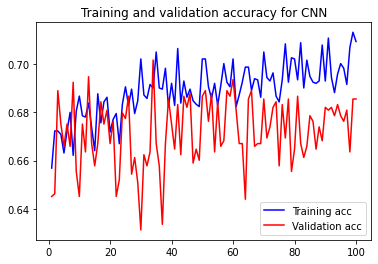

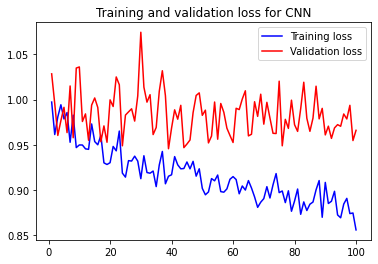

In [ ]:
#getting train and validation accuracies
train_acc_CNN = history.history['accuracy']
val_acc_CNN = history.history['val_accuracy']

#getting train and validation losses
train_loss_CNN = history.history['loss']
val_loss_CNN = history.history['val_loss']
epochs = range(1, len(train_loss_CNN) + 1)

#plotting the training and validation accurracies
plt.plot(epochs, train_acc_CNN, 'b', label='Training acc')
plt.plot(epochs, val_acc_CNN, 'r', label='Validation acc')
plt.title('Training and validation accuracy for CNN')
plt.legend()
plt.figure()

#plotting the train and validaiton losses
plt.plot(epochs, train_loss_CNN, 'b', label='Training loss')
plt.plot(epochs, val_loss_CNN, 'r', label='Validation loss')
plt.title('Training and validation loss for CNN')
plt.legend()

plt.show()

This model resulted in a higher accuracy overall for both training and validation only slightly. But the model is severely overfitting, the validation loss stays about the same while the training loss gets lower and lower.

#### Using a pretrained model / transfer learning

In [ ]:
#instantiate resnet50 model 
from tensorflow.keras.applications import ResNet50
conv_base = ResNet50(weights = 'imagenet', 
                     include_top = False, 
                     input_shape=(150,150,3))
#freeze weight of conv base so that their weights arent updated during training
conv_base.trainable=False

conv_base.summary()

94765736/94765736 [==============================] - 3s 0us/step
Model: "resnet50"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_4 (InputLayer)           [(None, 150, 150, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 156, 156, 3)  0           ['input_4[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 75, 75, 64)   9472        ['conv1_pad[0][0]']              
                                                                                                  
 conv1_bn (BatchNormalizat

In [ ]:
def build_pretrained(input_shape):
  input = keras.Input(shape=input_shape)
  x = data_augmentation(input)
  x = layers.experimental.preprocessing.Rescaling(1./255)(x)
  x = conv_base(x)
  x = layers.GlobalAveragePooling2D()(x)
  output = layers.Dense(11, activation = "softmax")(x)

  model = keras.Model(inputs=input, outputs=output)
  return model

pretrained_model = build_pretrained(input_shape=(150,150,3))
print(pretrained_model.summary())

Model: "model_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_5 (InputLayer)        [(None, 150, 150, 3)]     0         
                                                                 
 random_zoom_2 (RandomZoom)  (None, 150, 150, 3)       0         
                                                                 
 random_flip_2 (RandomFlip)  (None, 150, 150, 3)       0         
                                                                 
 rescaling_3 (Rescaling)     (None, 150, 150, 3)       0         
                                                                 
 resnet50 (Functional)       (None, 5, 5, 2048)        23587712  
                                                                 
 global_average_pooling2d_3   (None, 2048)             0         
 (GlobalAveragePooling2D)                                        
                                                           

In [ ]:
opt = tf.keras.optimizers.Adam(learning_rate = lr_schedule)
pretrained_model.compile(loss = "sparse_categorical_crossentropy",
                         metrics = ['accuracy'],
                         optimizer = opt)

history = pretrained_model.fit(
    u_train_dataset,
    validation_data = validation_dataset,
    epochs = 100,
    verbose = 1,
    callbacks = [early_stopping]
)

Epoch 1/100
130/130 [==============================] - 23s 142ms/step - loss: 2.2914 - accuracy: 0.1542 - val_loss: 2.2303 - val_accuracy: 0.2046
Epoch 2/100
130/130 [==============================] - 18s 135ms/step - loss: 2.2473 - accuracy: 0.1827 - val_loss: 2.1863 - val_accuracy: 0.2301
Epoch 3/100
130/130 [==============================] - 18s 134ms/step - loss: 2.2076 - accuracy: 0.2043 - val_loss: 2.1752 - val_accuracy: 0.2127
Epoch 4/100
130/130 [==============================] - 18s 135ms/step - loss: 2.1871 - accuracy: 0.2092 - val_loss: 2.1297 - val_accuracy: 0.2185
Epoch 5/100
130/130 [==============================] - 18s 133ms/step - loss: 2.1707 - accuracy: 0.2255 - val_loss: 2.1385 - val_accuracy: 0.2428
Epoch 6/100
130/130 [==============================] - 18s 134ms/step - loss: 2.1496 - accuracy: 0.2260 - val_loss: 2.1352 - val_accuracy: 0.2023
Epoch 7/100
130/130 [==============================] - 19s 137ms/step - loss: 2.1312 - accuracy: 0.2419 - val_loss: 2.1066 -

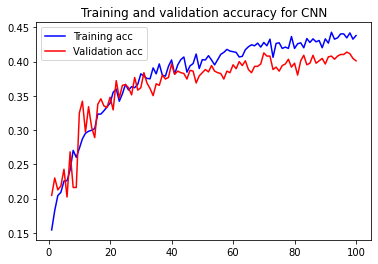

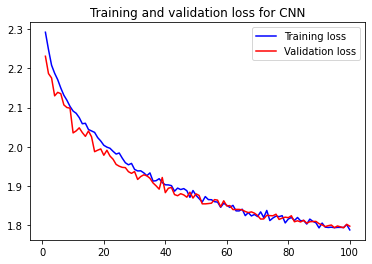

In [ ]:
#getting train and validation accuracies
train_acc_CNN = history.history['accuracy']
val_acc_CNN = history.history['val_accuracy']

#getting train and validation losses
train_loss_CNN = history.history['loss']
val_loss_CNN = history.history['val_loss']
epochs = range(1, len(train_loss_CNN) + 1)

#plotting the training and validation accurracies
plt.plot(epochs, train_acc_CNN, 'b', label='Training acc')
plt.plot(epochs, val_acc_CNN, 'r', label='Validation acc')
plt.title('Training and validation accuracy for CNN')
plt.legend()
plt.figure()

#plotting the train and validaiton losses
plt.plot(epochs, train_loss_CNN, 'b', label='Training loss')
plt.plot(epochs, val_loss_CNN, 'r', label='Validation loss')
plt.title('Training and validation loss for CNN')
plt.legend()

plt.show()

The shape of the curves of the pretrained model look better than the model's we've had before BUT the accuracy is lower and the loss is higher than the models I built from scratch. 

#### Fine Tuning

In [ ]:
#unfreeze conv base
conv_base.trainable = True

#tune the last conv block
for layer in conv_base.layers[:-9]:
  layer.trainable=False

for layer in conv_base.layers[-9:]:
  if layer.name.endswith("conv"):
    layer.trainable=True

print(pretrained_model.summary())

Model: "model_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_5 (InputLayer)        [(None, 150, 150, 3)]     0         
                                                                 
 random_zoom_2 (RandomZoom)  (None, 150, 150, 3)       0         
                                                                 
 random_flip_2 (RandomFlip)  (None, 150, 150, 3)       0         
                                                                 
 rescaling_3 (Rescaling)     (None, 150, 150, 3)       0         
                                                                 
 resnet50 (Functional)       (None, 5, 5, 2048)        23587712  
                                                                 
 global_average_pooling2d_3   (None, 2048)             0         
 (GlobalAveragePooling2D)                                        
                                                           

In [ ]:
opt = tf.keras.optimizers.Adam(learning_rate=1e-5)
pretrained_model.compile(loss="sparse_categorical_crossentropy",
                         metrics = ['accuracy'],
                         optimizer=opt)

history = pretrained_model.fit(
    u_train_dataset,
    validation_data = validation_dataset,
    epochs = 50,
    verbose = 1,
    callbacks=[early_stopping]
)

Epoch 1/50
130/130 [==============================] - 24s 154ms/step - loss: 1.1323 - accuracy: 0.6077 - val_loss: 1.5682 - val_accuracy: 0.5098
Epoch 2/50
130/130 [==============================] - 18s 137ms/step - loss: 1.0896 - accuracy: 0.6342 - val_loss: 1.6098 - val_accuracy: 0.4994
Epoch 3/50
130/130 [==============================] - 18s 136ms/step - loss: 1.0896 - accuracy: 0.6289 - val_loss: 1.5997 - val_accuracy: 0.5087
Epoch 4/50
130/130 [==============================] - 20s 152ms/step - loss: 1.0665 - accuracy: 0.6419 - val_loss: 1.5651 - val_accuracy: 0.5249
Epoch 5/50
130/130 [==============================] - 18s 136ms/step - loss: 1.0488 - accuracy: 0.6424 - val_loss: 1.6232 - val_accuracy: 0.4994
Epoch 6/50
130/130 [==============================] - 18s 137ms/step - loss: 1.0556 - accuracy: 0.6569 - val_loss: 1.6435 - val_accuracy: 0.4763
Epoch 7/50
130/130 [==============================] - 18s 138ms/step - loss: 1.0244 - accuracy: 0.6651 - val_loss: 1.6861 - val_ac

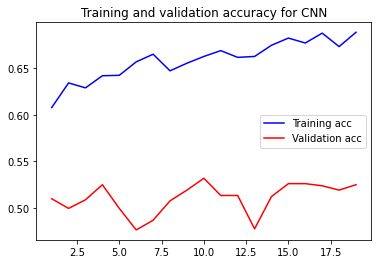

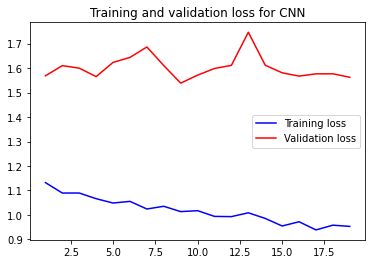

In [ ]:
#getting train and validation accuracies
train_acc_CNN = history.history['accuracy']
val_acc_CNN = history.history['val_accuracy']

#getting train and validation losses
train_loss_CNN = history.history['loss']
val_loss_CNN = history.history['val_loss']
epochs = range(1, len(train_loss_CNN) + 1)

#plotting the training and validation accurracies
plt.plot(epochs, train_acc_CNN, 'b', label='Training acc')
plt.plot(epochs, val_acc_CNN, 'r', label='Validation acc')
plt.title('Training and validation accuracy for CNN')
plt.legend()
plt.figure()

#plotting the train and validaiton losses
plt.plot(epochs, train_loss_CNN, 'b', label='Training loss')
plt.plot(epochs, val_loss_CNN, 'r', label='Validation loss')
plt.title('Training and validation loss for CNN')
plt.legend()

plt.show()

This model has slightly better accuracy and lower training loss than the previous model but still not performing very well at all and overfitting.

#### Setting class_weights

In [ ]:
import pandas as pd
artists = pd.read_csv("artists.csv")
artists.shape

(50, 8)

In [ ]:
artists = artists.sort_values(by=['paintings'], ascending=False)

top_10 = artists[artists['paintings'] > 200].reset_index()
top_10 = top_10[['name', 'paintings']]
top_10['class_weight'] = top_10.paintings.sum()/(top_10.shape[0]*top_10.paintings)

In [ ]:
top_10

,name,paintings,class_weight
0,Vincent van Gogh,877,0.445631
1,Edgar Degas,702,0.556721
2,Pablo Picasso,439,0.890246
3,Pierre-Auguste Renoir,336,1.163149
4,Albrecht Dürer,328,1.191519
5,Paul Gauguin,311,1.256650
6,Francisco Goya,291,1.343018
7,Rembrandt,262,1.491672
8,Alfred Sisley,259,1.508951
9,Titian,255,1.532620


In [ ]:
class_weights = top_10['class_weight'].to_dict()
class_weights

{0: 0.44563076604125634,
 1: 0.5567210567210568,
 2: 0.8902464278318493,
 3: 1.1631493506493507,
 4: 1.1915188470066518,
 5: 1.2566501023092662,
 6: 1.3430178069353327,
 7: 1.491672449687717,
 8: 1.5089505089505089,
 9: 1.532620320855615,
 10: 1.6352225180677062}

In [ ]:
print(len(os.listdir("seg_train/Edgar_Degas")))
print(len(os.listdir("seg_train/Vincent_van_Gogh")))

221
226


In [ ]:
#put the extra images back into seg_train
dataset_directory = "extra_images/Edgar_Degas"
degas_files = os.listdir(dataset_directory)
for i in degas_files:
  src = os.path.join(dataset_directory,i)
  dst = os.path.join(train_Edgar_Degas, i)
  shutil.move(src, dst)
print(len(os.listdir("seg_train/Edgar_Degas")))

dataset_directory = "extra_images/Vincent_van_Gogh"
vangogh_files = os.listdir(dataset_directory)
for i in vangogh_files:
  src = os.path.join(dataset_directory, i)
  dst = os.path.join(train_Vincent_van_Gogh, i)
  shutil.move(src, dst)
print(len(os.listdir("seg_train/Vincent_van_Gogh")))

421
526


In [ ]:
print(len(os.listdir("extra_images/Edgar_Degas")))
print(len(os.listdir("extra_images/Vincent_van_Gogh")))

0
0


In [ ]:
#turn the og dataset into a tensor
train_dataset = image_dataset_from_directory(
    "seg_train",
    image_size=(150,150),
    batch_size=16
)

Found 2575 files belonging to 11 classes.


In [ ]:
second_base = ResNet50(weights='imagenet',
                       include_top=False,
                       input_shape=(150,150,3)
)
second_base.trainable=False

second_base.summary()

Model: "resnet50"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_6 (InputLayer)           [(None, 150, 150, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 156, 156, 3)  0           ['input_6[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 75, 75, 64)   9472        ['conv1_pad[0][0]']              
                                                                                                  
 conv1_bn (BatchNormalization)  (None, 75, 75, 64)   256         ['conv1_conv[0][0]']      

In [ ]:
def build_pretrained_2(input_shape):
  input = keras.Input(shape=input_shape)
  x = data_augmentation(input)
  x = layers.experimental.preprocessing.Rescaling(1./255)(x)
  x = conv_base(x)
  x = layers.GlobalAveragePooling2D()(x)

  #adding 1 more dense layer after GAP layer since I do not expect imagenet 
  #to have similar images to this dataset
  x = layers.Dense(32, kernel_initializer=tf.keras.initializers.he_normal(seed=1))(x)
  x = layers.BatchNormalization()(x)
  x = layers.ReLU()(x)
  
  output = layers.Dense(11, activation = "softmax")(x)

  model = keras.Model(inputs=input, outputs=output)
  return model

pretrained_model_2 = build_pretrained_2(input_shape=(150,150,3))
print(pretrained_model_2.summary())

Model: "model_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_9 (InputLayer)        [(None, 150, 150, 3)]     0         
                                                                 
 random_zoom_5 (RandomZoom)  (None, 150, 150, 3)       0         
                                                                 
 random_flip_5 (RandomFlip)  (None, 150, 150, 3)       0         
                                                                 
 rescaling_6 (Rescaling)     (None, 150, 150, 3)       0         
                                                                 
 resnet50 (Functional)       (None, 5, 5, 2048)        23587712  
                                                                 
 global_average_pooling2d_6   (None, 2048)             0         
 (GlobalAveragePooling2D)                                        
                                                           

In [ ]:
opt = tf.keras.optimizers.Adam(learning_rate = lr_schedule)
pretrained_model_2.compile(loss = "sparse_categorical_crossentropy",
                         metrics = ['accuracy'],
                         optimizer = opt)

history1 = pretrained_model_2.fit(
    train_dataset,
    validation_data = validation_dataset,
    epochs = 100,
    verbose = 1,
    class_weight = class_weights,  #using class weights
    callbacks = [early_stopping]
)

Epoch 1/100
161/161 [==============================] - 26s 137ms/step - loss: 1.9947 - accuracy: 0.4664 - val_loss: 2.1118 - val_accuracy: 0.2173
Epoch 2/100
161/161 [==============================] - 25s 154ms/step - loss: 1.6819 - accuracy: 0.5115 - val_loss: 2.5181 - val_accuracy: 0.2590
Epoch 3/100
161/161 [==============================] - 22s 130ms/step - loss: 1.6148 - accuracy: 0.5173 - val_loss: 2.3066 - val_accuracy: 0.3468
Epoch 4/100
161/161 [==============================] - 22s 131ms/step - loss: 1.5711 - accuracy: 0.5344 - val_loss: 2.0799 - val_accuracy: 0.3584
Epoch 5/100
161/161 [==============================] - 22s 130ms/step - loss: 1.4785 - accuracy: 0.5635 - val_loss: 1.9921 - val_accuracy: 0.3792
Epoch 6/100
161/161 [==============================] - 21s 129ms/step - loss: 1.4796 - accuracy: 0.5584 - val_loss: 1.9125 - val_accuracy: 0.4046
Epoch 7/100
161/161 [==============================] - 21s 129ms/step - loss: 1.4463 - accuracy: 0.5612 - val_loss: 2.3610 -

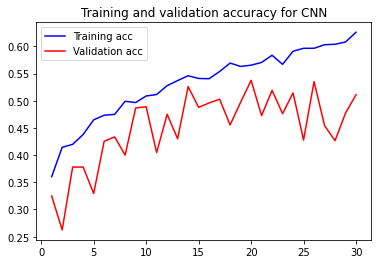

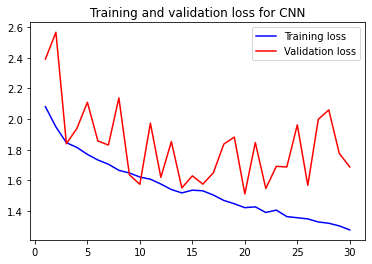

In [ ]:
#getting train and validation accuracies
train_acc_CNN = history1.history['accuracy']
val_acc_CNN = history1.history['val_accuracy']

#getting train and validation losses
train_loss_CNN = history1.history['loss']
val_loss_CNN = history1.history['val_loss']
epochs = range(1, len(train_loss_CNN) + 1)

#plotting the training and validation accurracies
plt.plot(epochs, train_acc_CNN, 'b', label='Training acc')
plt.plot(epochs, val_acc_CNN, 'r', label='Validation acc')
plt.title('Training and validation accuracy for CNN')
plt.legend()
plt.figure()

#plotting the train and validaiton losses
plt.plot(epochs, train_loss_CNN, 'b', label='Training loss')
plt.plot(epochs, val_loss_CNN, 'r', label='Validation loss')
plt.title('Training and validation loss for CNN')
plt.legend()

plt.show()

In [ ]:
#unfreeze conv base
second_base.trainable = True

#tune the last conv block
for layer in second_base.layers[:-9]:
  layer.trainable=False

for layer in second_base.layers[-9:]:
  if layer.name.endswith("conv"):
    layer.trainable=True

print(pretrained_model_2.summary())

Model: "model_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_9 (InputLayer)        [(None, 150, 150, 3)]     0         
                                                                 
 random_zoom_5 (RandomZoom)  (None, 150, 150, 3)       0         
                                                                 
 random_flip_5 (RandomFlip)  (None, 150, 150, 3)       0         
                                                                 
 rescaling_6 (Rescaling)     (None, 150, 150, 3)       0         
                                                                 
 resnet50 (Functional)       (None, 5, 5, 2048)        23587712  
                                                                 
 global_average_pooling2d_6   (None, 2048)             0         
 (GlobalAveragePooling2D)                                        
                                                           

In [ ]:
opt = tf.keras.optimizers.Adam(learning_rate=1e-5)
pretrained_model.compile(loss="sparse_categorical_crossentropy",
                         metrics = ['accuracy'],
                         optimizer=opt)

history3 = pretrained_model_2.fit(
    train_dataset,
    validation_data = validation_dataset,
    epochs = 50,
    verbose = 1,
    class_weight = class_weights,
    callbacks=[early_stopping]
)

Epoch 1/50
161/161 [==============================] - 22s 129ms/step - loss: 1.2376 - accuracy: 0.6350 - val_loss: 2.2804 - val_accuracy: 0.3549
Epoch 2/50
161/161 [==============================] - 22s 130ms/step - loss: 1.2510 - accuracy: 0.6369 - val_loss: 1.7399 - val_accuracy: 0.4543
Epoch 3/50
161/161 [==============================] - 21s 129ms/step - loss: 1.2007 - accuracy: 0.6427 - val_loss: 1.9883 - val_accuracy: 0.4613
Epoch 4/50
161/161 [==============================] - 21s 128ms/step - loss: 1.1920 - accuracy: 0.6462 - val_loss: 1.8256 - val_accuracy: 0.4312
Epoch 5/50
161/161 [==============================] - 21s 129ms/step - loss: 1.2276 - accuracy: 0.6334 - val_loss: 1.7381 - val_accuracy: 0.4590
Epoch 6/50
161/161 [==============================] - 25s 152ms/step - loss: 1.1790 - accuracy: 0.6419 - val_loss: 2.1102 - val_accuracy: 0.4636
Epoch 7/50
161/161 [==============================] - 21s 129ms/step - loss: 1.1705 - accuracy: 0.6528 - val_loss: 2.0071 - val_ac

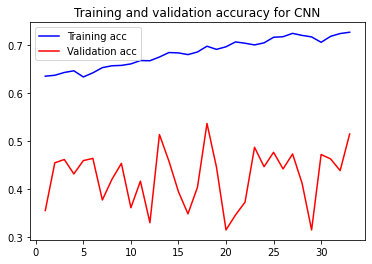

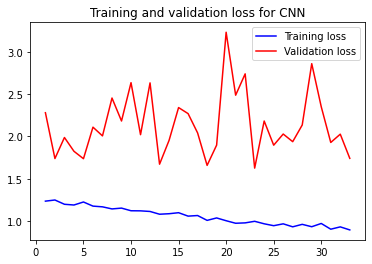

In [ ]:
#getting train and validation accuracies
train_acc_CNN = history3.history['accuracy']
val_acc_CNN = history3.history['val_accuracy']

#getting train and validation losses
train_loss_CNN = history3.history['loss']
val_loss_CNN = history3.history['val_loss']
epochs = range(1, len(train_loss_CNN) + 1)

#plotting the training and validation accurracies
plt.plot(epochs, train_acc_CNN, 'b', label='Training acc')
plt.plot(epochs, val_acc_CNN, 'r', label='Validation acc')
plt.title('Training and validation accuracy for CNN')
plt.legend()
plt.figure()

#plotting the train and validaiton losses
plt.plot(epochs, train_loss_CNN, 'b', label='Training loss')
plt.plot(epochs, val_loss_CNN, 'r', label='Validation loss')
plt.title('Training and validation loss for CNN')
plt.legend()

plt.show()

After using class_weights as a similar work had done, the model is still severely overfitting but training accuracy improved a little.

# Evaluation

the best model so far was the model that used undersampling that achieved 70% training accuracy and 68% training accuracy. So we will evaluate this model on the training data.

In [ ]:
#create tf.data.dataset for seg_test
test_dataset = image_dataset_from_directory(
    "seg_train",
    image_size=(150,150),
    batch_size=16,
    shuffle=False
)

Found 2575 files belonging to 11 classes.


In [ ]:
test_loss, test_acc = baseline_with_resaug.evaluate(test_dataset)
print("test acc: ", test_acc)

161/161 [==============================] - 13s 82ms/step - loss: 0.8030 - accuracy: 0.7122
test acc:  0.7122330069541931


In [ ]:
predicted_probabilities = baseline_with_resaug.predict(test_dataset)
max_predictions = np.argmax(predicted_probabilities, axis = 1)
true_class_indices = np.concatenate([y for x, y in test_dataset], axis=0)

161/161 [==============================] - 13s 82ms/step


In [ ]:
#confusion matrix
import sklearn
from sklearn import metrics
cm = sklearn.metrics.confusion_matrix(true_class_indices, max_predictions)
cm

array([[145,   2,   1,  14,   2,   8,   1,   0,   0,   0,  23],
       [  0, 138,   0,   0,   0,   1,   3,   0,   0,   0,  13],
       [  0,   4, 307,   4,   2,  29,  12,  12,   7,   3,  41],
       [  4,   2,  15,  91,   0,  12,   2,   2,  20,  12,  14],
       [  2,   0,   0,   8, 110,  16,   0,   2,   0,   0,   5],
       [  2,   0,   7,   1,   3, 209,   5,   5,   0,   0,  31],
       [  0,  19,   9,   5,   1,   2, 136,   0,   0,   0,  14],
       [  0,   7,  42,   0,   0,   5,   2, 124,   0,   4,  17],
       [  0,   1,   4,   3,   0,   0,   1,   1, 138,   8,   1],
       [  0,   0,  10,   5,   0,   9,   2,   2,  36,  77,  12],
       [ 16,  15,  21,  22,   2,  72,   4,   2,  11,   2, 359]])

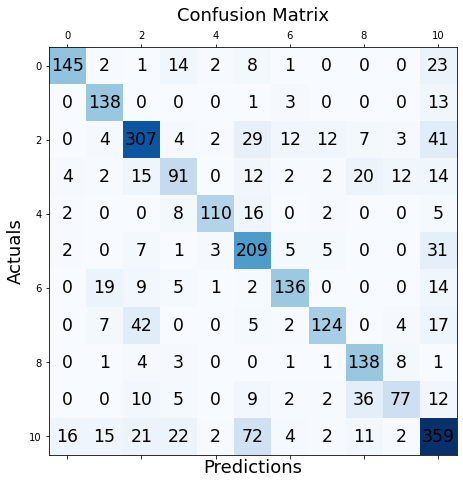

In [ ]:
fig, ax = plt.subplots(figsize=(7.5, 7.5))
ax.matshow(cm, cmap=plt.cm.Blues)
for i in range(cm.shape[0]):
  for j in range(cm.shape[1]):
    ax.text(x=j, y=i, s=cm[i,j], va='center',ha='center',
            size='xx-large')
plt.xlabel('Predictions', fontsize=18)
plt.ylabel('Actuals', fontsize=18)
plt.title('Confusion Matrix', fontsize=18)
plt.show()

The model did well on Edgar Degas and Vincent Van Gogh which were the two artists that had the most data. It looks like Pablo_Picasso also did relatively well. Picasso's paintings are very abstract and different so the model could have picked up on those differences better than other artists.

1/1 [==============================] - 0s 27ms/step
True label is: Albrecht_Durer, CNN predicted Francisco Goya with confidence 0.4567164182662964


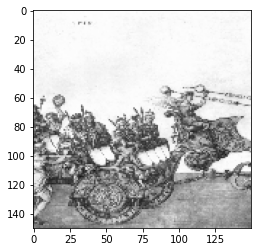

True label is: Albrecht_Durer, CNN predicted Pablo Picasso with confidence 0.9222832322120667


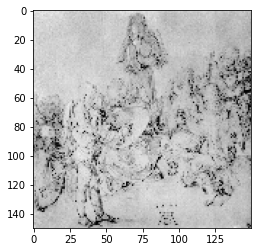

True label is: Albrecht_Durer, CNN predicted Vincent van Gogh with confidence 0.49164775013923645


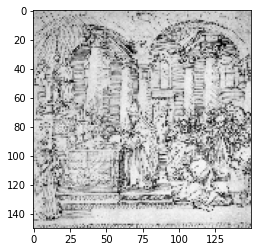

True label is: Albrecht_Durer, CNN predicted Francisco Goya with confidence 0.6641191840171814


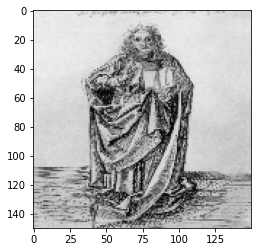

True label is: Albrecht_Durer, CNN predicted Vincent van Gogh with confidence 0.6119610667228699


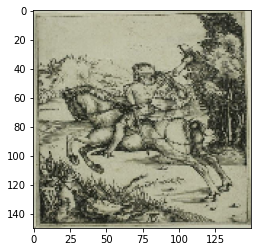

1/1 [==============================] - 0s 34ms/step
True label is: Albrecht_Durer, CNN predicted Vincent van Gogh with confidence 0.857316255569458


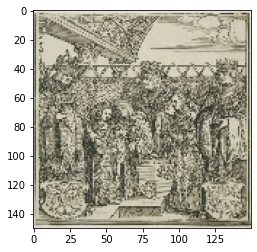

True label is: Albrecht_Durer, CNN predicted Vincent van Gogh with confidence 0.6206475496292114


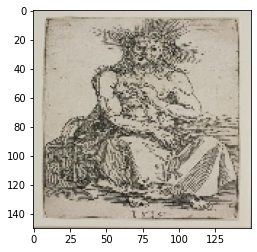

1/1 [==============================] - 0s 28ms/step
True label is: Albrecht_Durer, CNN predicted Vincent van Gogh with confidence 0.7816354036331177


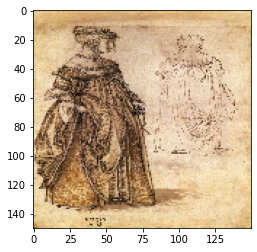

True label is: Albrecht_Durer, CNN predicted Alfred Sisley with confidence 0.6737477779388428


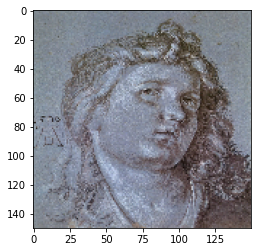

True label is: Albrecht_Durer, CNN predicted Vincent van Gogh with confidence 0.42232000827789307


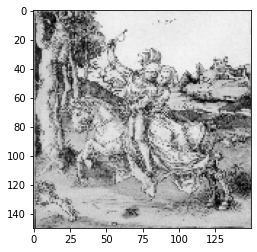

True label is: Albrecht_Durer, CNN predicted Pablo Picasso with confidence 0.6054280996322632


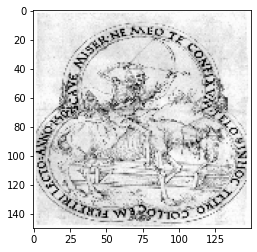

True label is: Albrecht_Durer, CNN predicted Vincent van Gogh with confidence 0.646645724773407


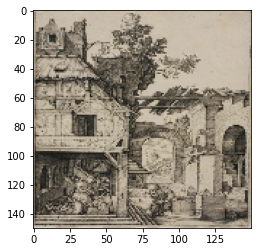

1/1 [==============================] - 0s 57ms/step
True label is: Albrecht_Durer, CNN predicted Vincent van Gogh with confidence 0.3599297106266022


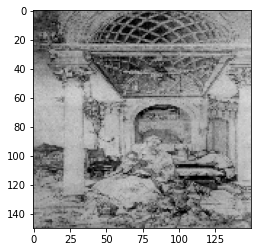

True label is: Albrecht_Durer, CNN predicted Francisco Goya with confidence 0.7041928172111511


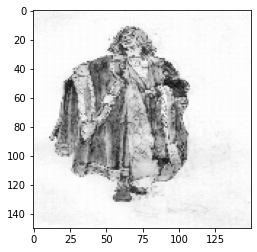

True label is: Albrecht_Durer, CNN predicted Vincent van Gogh with confidence 0.6807253956794739


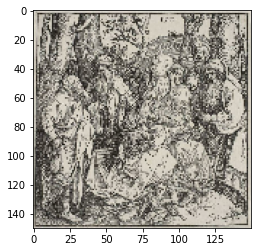

True label is: Albrecht_Durer, CNN predicted Francisco Goya with confidence 0.44162696599960327


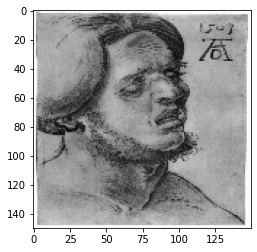

True label is: Albrecht_Durer, CNN predicted Pablo Picasso with confidence 0.9235060214996338


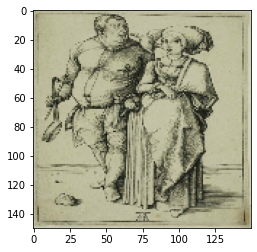

True label is: Albrecht_Durer, CNN predicted Vincent van Gogh with confidence 0.49470973014831543


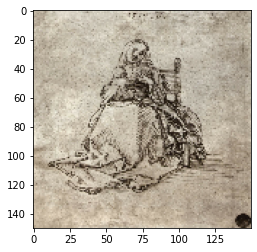

1/1 [==============================] - 0s 42ms/step
True label is: Albrecht_Durer, CNN predicted Pablo Picasso with confidence 0.8335975408554077


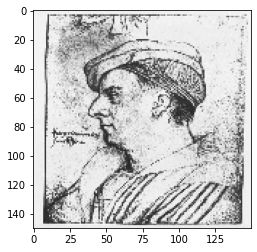

1/1 [==============================] - 0s 55ms/step
True label is: Albrecht_Durer, CNN predicted Vincent van Gogh with confidence 0.47683602571487427


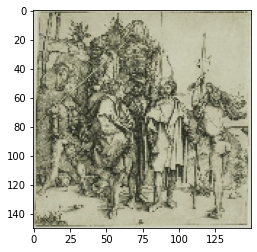

True label is: Albrecht_Durer, CNN predicted Francisco Goya with confidence 0.550530195236206


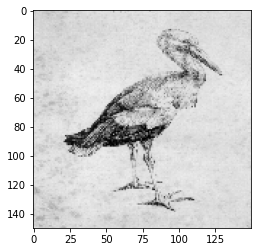

True label is: Albrecht_Durer, CNN predicted Pablo Picasso with confidence 0.44636377692222595


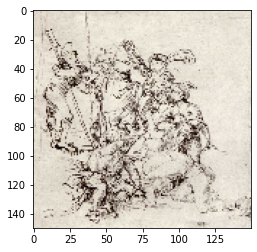

True label is: Albrecht_Durer, CNN predicted Vincent van Gogh with confidence 0.49991631507873535


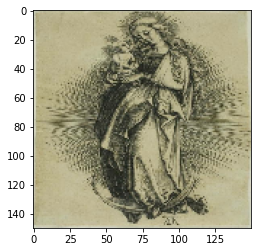

1/1 [==============================] - 0s 61ms/step
True label is: Albrecht_Durer, CNN predicted Vincent van Gogh with confidence 0.49213093519210815


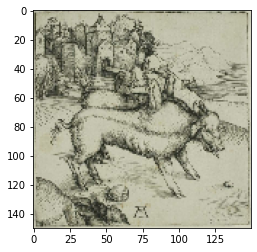

True label is: Albrecht_Durer, CNN predicted Vincent van Gogh with confidence 0.7418848276138306


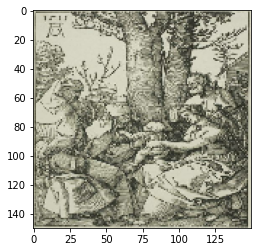

True label is: Albrecht_Durer, CNN predicted Vincent van Gogh with confidence 0.3178556561470032


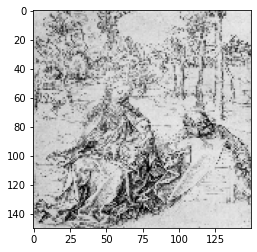

True label is: Albrecht_Durer, CNN predicted Francisco Goya with confidence 0.7537059783935547


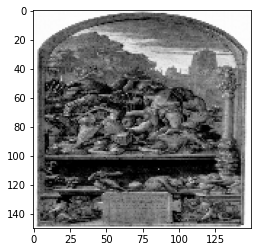

True label is: Albrecht_Durer, CNN predicted Paul Gauguin with confidence 0.6006852984428406


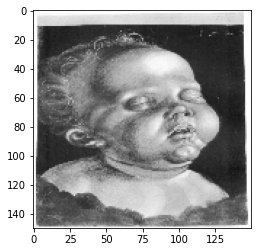

True label is: Albrecht_Durer, CNN predicted Marc Chagall with confidence 0.3958946168422699


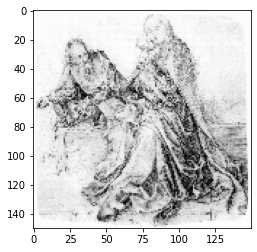

1/1 [==============================] - 0s 47ms/step
True label is: Albrecht_Durer, CNN predicted Francisco Goya with confidence 0.41801437735557556


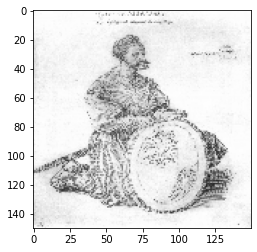

True label is: Albrecht_Durer, CNN predicted Vincent van Gogh with confidence 0.348987877368927


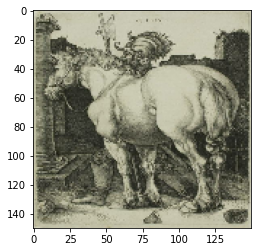

True label is: Albrecht_Durer, CNN predicted Francisco Goya with confidence 0.3951004445552826


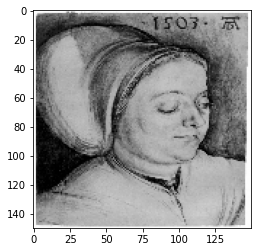

1/1 [==============================] - 0s 51ms/step
True label is: Albrecht_Durer, CNN predicted Francisco Goya with confidence 0.2765268385410309


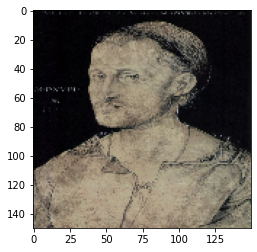

True label is: Albrecht_Durer, CNN predicted Vincent van Gogh with confidence 0.442961722612381


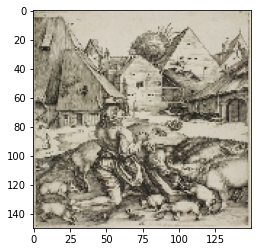

True label is: Albrecht_Durer, CNN predicted Vincent van Gogh with confidence 0.7515825033187866


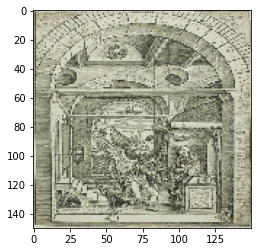

True label is: Albrecht_Durer, CNN predicted Edgar_Degas with confidence 0.3794748783111572


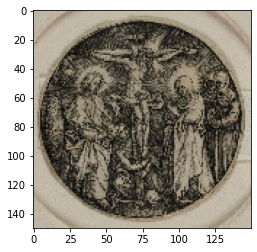

1/1 [==============================] - 0s 40ms/step
True label is: Albrecht_Durer, CNN predicted Pablo Picasso with confidence 0.7677807211875916


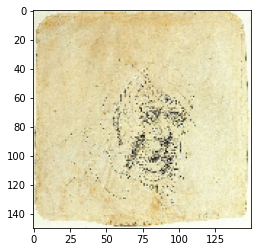

True label is: Albrecht_Durer, CNN predicted Francisco Goya with confidence 0.738056480884552


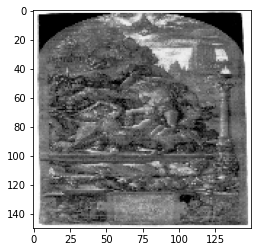

True label is: Albrecht_Durer, CNN predicted Francisco Goya with confidence 0.39222827553749084


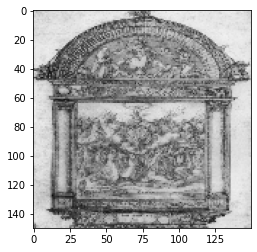

True label is: Albrecht_Durer, CNN predicted Francisco Goya with confidence 0.5776461958885193


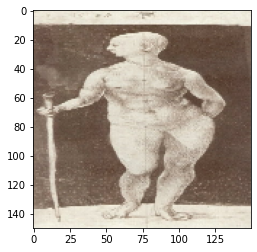

True label is: Albrecht_Durer, CNN predicted Pablo Picasso with confidence 0.4556780755519867


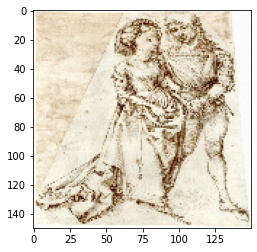

True label is: Albrecht_Durer, CNN predicted Vincent van Gogh with confidence 0.22635579109191895


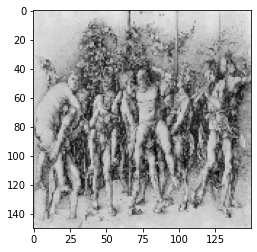

1/1 [==============================] - 0s 76ms/step
True label is: Albrecht_Durer, CNN predicted Alfred Sisley with confidence 0.468265175819397


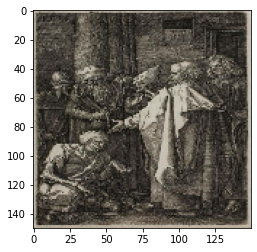

True label is: Albrecht_Durer, CNN predicted Vincent van Gogh with confidence 0.6611179113388062


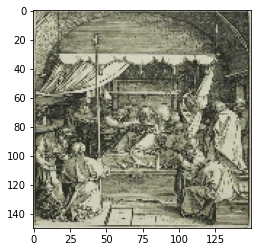

1/1 [==============================] - 0s 79ms/step
True label is: Albrecht_Durer, CNN predicted Vincent van Gogh with confidence 0.3157174587249756


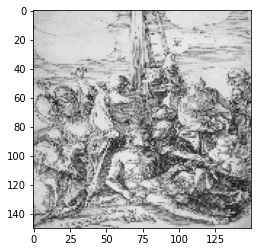

True label is: Albrecht_Durer, CNN predicted Vincent van Gogh with confidence 0.7065711617469788


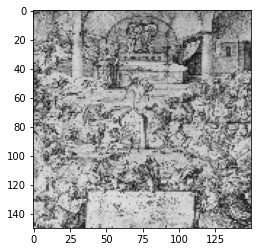

True label is: Albrecht_Durer, CNN predicted Francisco Goya with confidence 0.5713904500007629


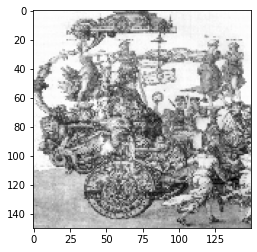

True label is: Albrecht_Durer, CNN predicted Pablo Picasso with confidence 0.5700711011886597


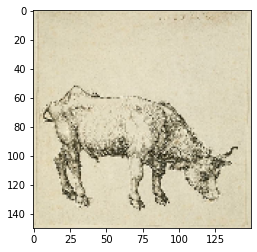

True label is: Albrecht_Durer, CNN predicted Marc Chagall with confidence 0.3501971960067749


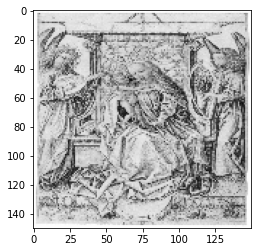

True label is: Albrecht_Durer, CNN predicted Vincent van Gogh with confidence 0.3666769564151764


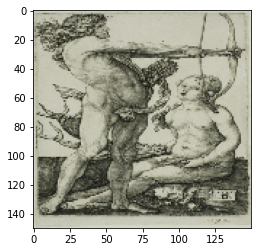

1/1 [==============================] - 0s 74ms/step
True label is: Albrecht_Durer, CNN predicted Francisco Goya with confidence 0.40842223167419434


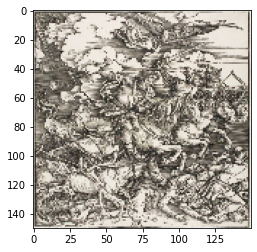

True label is: Alfred Sisley, CNN predicted Pablo Picasso with confidence 0.3783492147922516


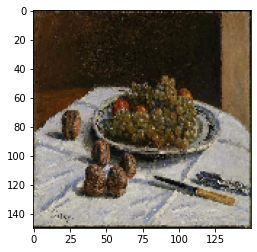

1/1 [==============================] - 0s 69ms/step
True label is: Alfred Sisley, CNN predicted Vincent van Gogh with confidence 0.8462224006652832


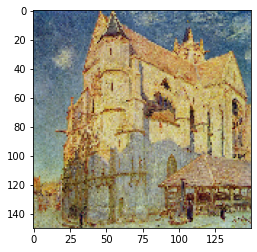

True label is: Alfred Sisley, CNN predicted Vincent van Gogh with confidence 0.8053724765777588


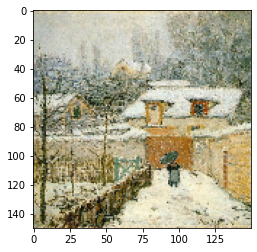

1/1 [==============================] - 0s 44ms/step
True label is: Alfred Sisley, CNN predicted Vincent van Gogh with confidence 0.4058420658111572


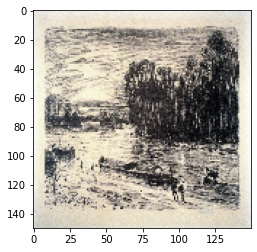

True label is: Alfred Sisley, CNN predicted Paul Gauguin with confidence 0.6724218130111694


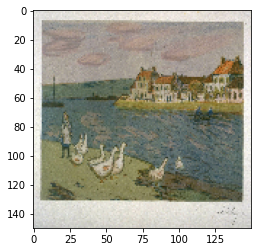

1/1 [==============================] - 0s 98ms/step
True label is: Alfred Sisley, CNN predicted Vincent van Gogh with confidence 0.24340401589870453


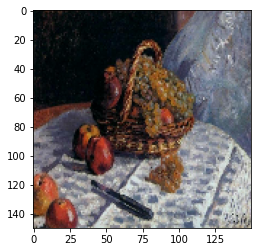

True label is: Alfred Sisley, CNN predicted Vincent van Gogh with confidence 0.6846517324447632


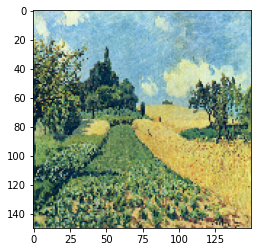

1/1 [==============================] - 0s 57ms/step
True label is: Alfred Sisley, CNN predicted Vincent van Gogh with confidence 0.5928727984428406


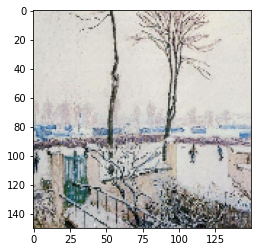

True label is: Alfred Sisley, CNN predicted Paul Gauguin with confidence 0.3747853934764862


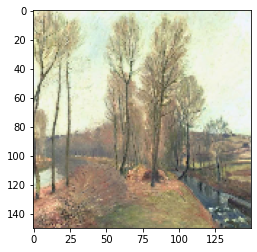

True label is: Alfred Sisley, CNN predicted Vincent van Gogh with confidence 0.6711453199386597


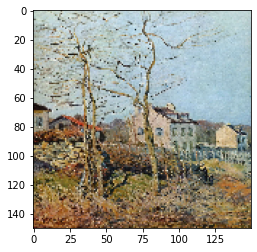

1/1 [==============================] - 0s 64ms/step
True label is: Alfred Sisley, CNN predicted Vincent van Gogh with confidence 0.5235883593559265


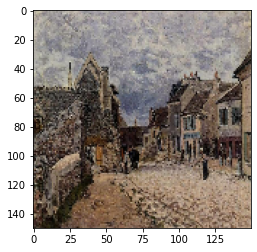

True label is: Alfred Sisley, CNN predicted Vincent van Gogh with confidence 0.7063579559326172


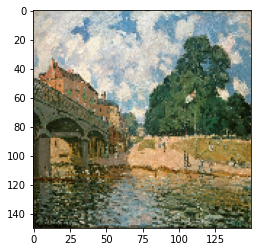

1/1 [==============================] - 0s 83ms/step
True label is: Alfred Sisley, CNN predicted Paul Gauguin with confidence 0.5158057808876038


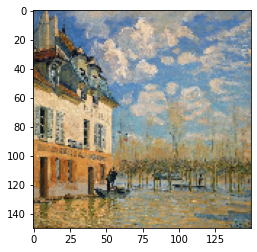

True label is: Alfred Sisley, CNN predicted Vincent van Gogh with confidence 0.6802805066108704


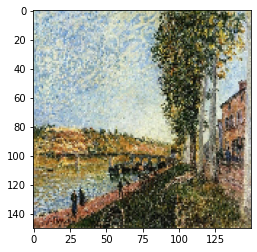

True label is: Alfred Sisley, CNN predicted Vincent van Gogh with confidence 0.4337538182735443


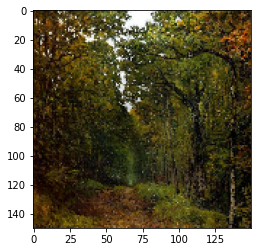

1/1 [==============================] - 0s 57ms/step
True label is: Alfred Sisley, CNN predicted Vincent van Gogh with confidence 0.42653602361679077


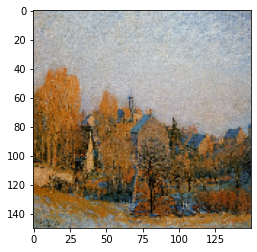

1/1 [==============================] - 0s 68ms/step
True label is: Alfred Sisley, CNN predicted Vincent van Gogh with confidence 0.7123534679412842


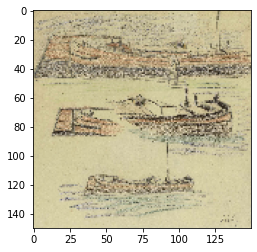

True label is: Edgar_Degas, CNN predicted Alfred Sisley with confidence 0.8101481795310974


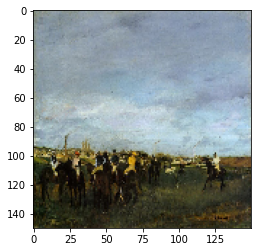

1/1 [==============================] - 0s 44ms/step
True label is: Edgar_Degas, CNN predicted Pablo Picasso with confidence 0.5199428200721741


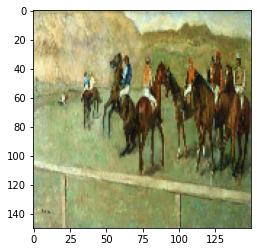

True label is: Edgar_Degas, CNN predicted Pablo Picasso with confidence 0.37816959619522095


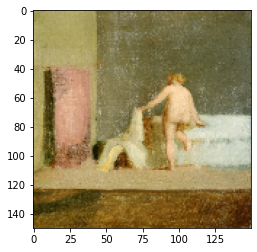

True label is: Edgar_Degas, CNN predicted Pablo Picasso with confidence 0.44144922494888306


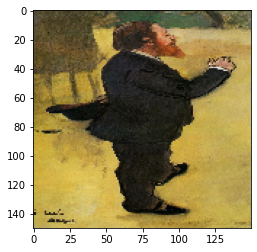

True label is: Edgar_Degas, CNN predicted Vincent van Gogh with confidence 0.8425207138061523


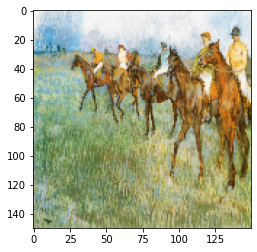

1/1 [==============================] - 0s 79ms/step
True label is: Edgar_Degas, CNN predicted Rembrandt with confidence 0.38911253213882446


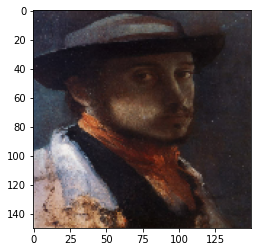

True label is: Edgar_Degas, CNN predicted Paul Gauguin with confidence 0.44356662034988403


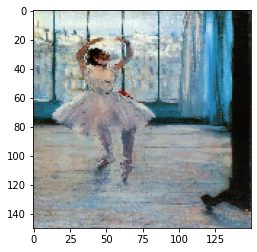

True label is: Edgar_Degas, CNN predicted Vincent van Gogh with confidence 0.43145638704299927


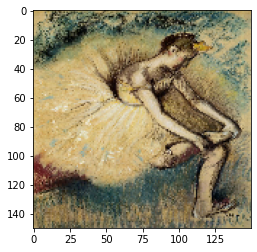

True label is: Edgar_Degas, CNN predicted Vincent van Gogh with confidence 0.7597969174385071


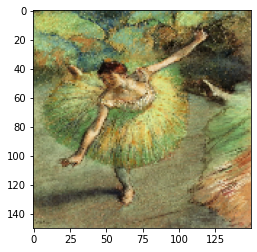

True label is: Edgar_Degas, CNN predicted Vincent van Gogh with confidence 0.3968966007232666


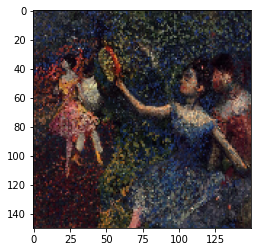

True label is: Edgar_Degas, CNN predicted Pablo Picasso with confidence 0.6006675362586975


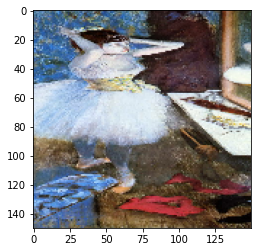

1/1 [==============================] - 0s 55ms/step
True label is: Edgar_Degas, CNN predicted Pierre Aguste Renoir with confidence 0.348021924495697


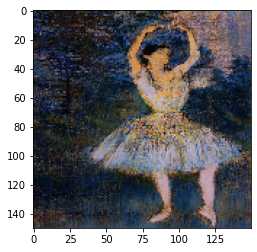

True label is: Edgar_Degas, CNN predicted Pablo Picasso with confidence 0.9390596747398376


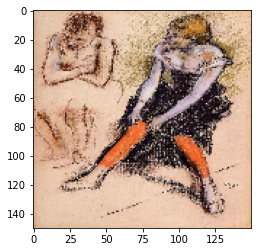

True label is: Edgar_Degas, CNN predicted Pierre Aguste Renoir with confidence 0.48230302333831787


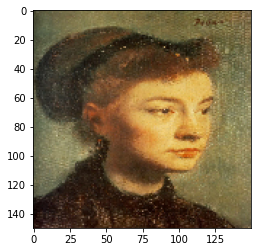

True label is: Edgar_Degas, CNN predicted Vincent van Gogh with confidence 0.8628574013710022


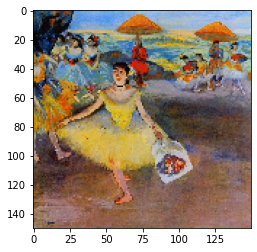

True label is: Edgar_Degas, CNN predicted Vincent van Gogh with confidence 0.37447163462638855


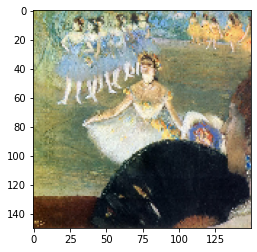

True label is: Edgar_Degas, CNN predicted Vincent van Gogh with confidence 0.3537876605987549


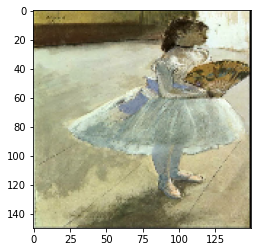

True label is: Edgar_Degas, CNN predicted Pablo Picasso with confidence 0.4248565435409546


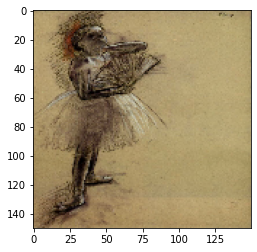

True label is: Edgar_Degas, CNN predicted Marc Chagall with confidence 0.5941969752311707


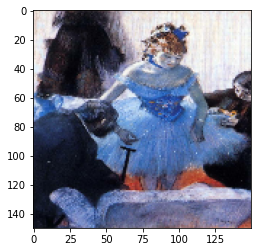

True label is: Edgar_Degas, CNN predicted Paul Gauguin with confidence 0.5468460917472839


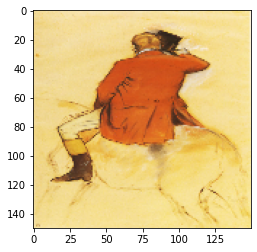

True label is: Edgar_Degas, CNN predicted Vincent van Gogh with confidence 0.6049179434776306


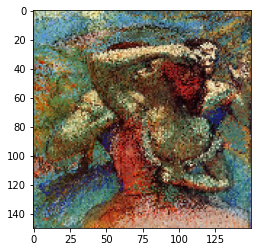

1/1 [==============================] - 0s 84ms/step
True label is: Edgar_Degas, CNN predicted Francisco Goya with confidence 0.4421519637107849


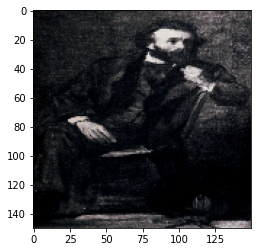

True label is: Edgar_Degas, CNN predicted Pablo Picasso with confidence 0.7257300019264221


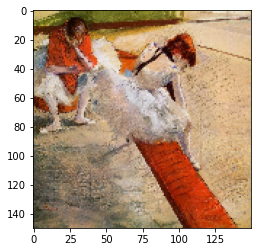

True label is: Edgar_Degas, CNN predicted Vincent van Gogh with confidence 0.36146777868270874


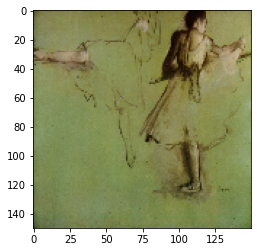

1/1 [==============================] - 0s 93ms/step
True label is: Edgar_Degas, CNN predicted Vincent van Gogh with confidence 0.695476233959198


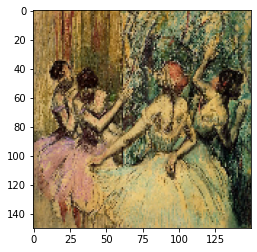

True label is: Edgar_Degas, CNN predicted Vincent van Gogh with confidence 0.49068814516067505


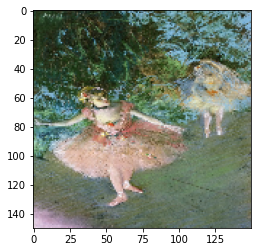

True label is: Edgar_Degas, CNN predicted Pierre Aguste Renoir with confidence 0.3945341110229492


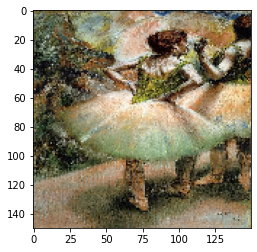

True label is: Edgar_Degas, CNN predicted Pierre Aguste Renoir with confidence 0.464798241853714


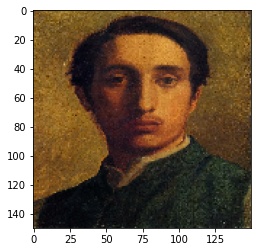

True label is: Edgar_Degas, CNN predicted Rembrandt with confidence 0.5713246464729309


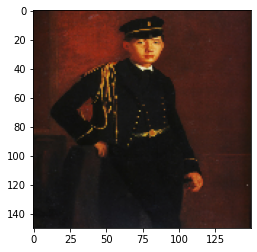

True label is: Edgar_Degas, CNN predicted Vincent van Gogh with confidence 0.5617853403091431


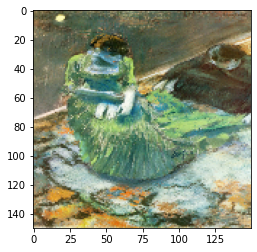

True label is: Edgar_Degas, CNN predicted Pablo Picasso with confidence 0.8136441111564636


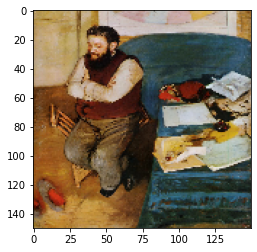

True label is: Edgar_Degas, CNN predicted Pablo Picasso with confidence 0.2580839991569519


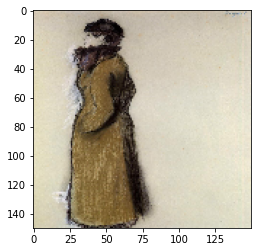

1/1 [==============================] - 0s 68ms/step
True label is: Edgar_Degas, CNN predicted Paul Gauguin with confidence 0.5465663075447083


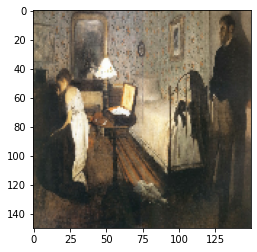

True label is: Edgar_Degas, CNN predicted Vincent van Gogh with confidence 0.4417255222797394


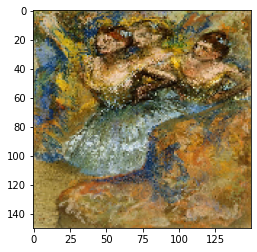

True label is: Edgar_Degas, CNN predicted Pierre Aguste Renoir with confidence 0.3636370003223419


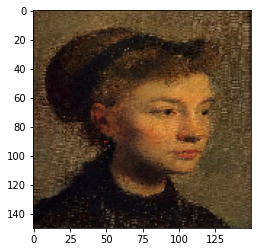

True label is: Edgar_Degas, CNN predicted Vincent van Gogh with confidence 0.4997820556163788


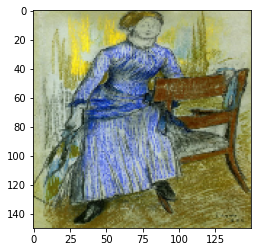

True label is: Edgar_Degas, CNN predicted Vincent van Gogh with confidence 0.5082008242607117


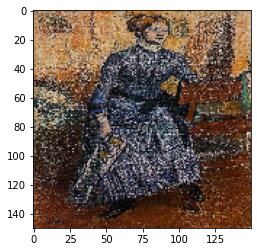

True label is: Edgar_Degas, CNN predicted Pablo Picasso with confidence 0.47105643153190613


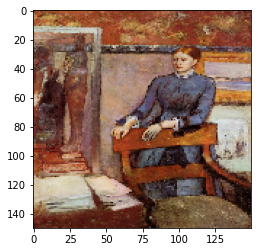

1/1 [==============================] - 0s 62ms/step
True label is: Edgar_Degas, CNN predicted Paul Gauguin with confidence 0.44824865460395813


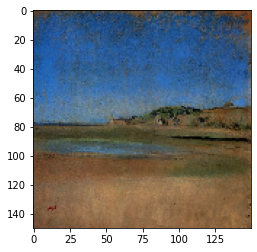

True label is: Edgar_Degas, CNN predicted Vincent van Gogh with confidence 0.9487788081169128


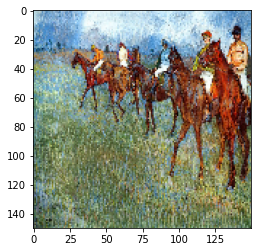

1/1 [==============================] - 0s 48ms/step
True label is: Edgar_Degas, CNN predicted Pierre Aguste Renoir with confidence 0.4513947069644928


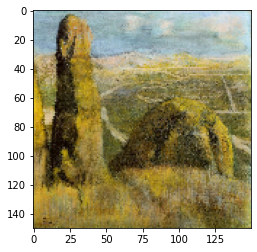

True label is: Edgar_Degas, CNN predicted Vincent van Gogh with confidence 0.6141732335090637


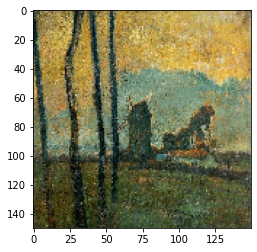

True label is: Edgar_Degas, CNN predicted Alfred Sisley with confidence 0.47520196437835693


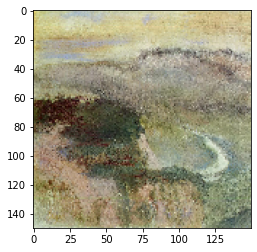

True label is: Edgar_Degas, CNN predicted Vincent van Gogh with confidence 0.4946061968803406


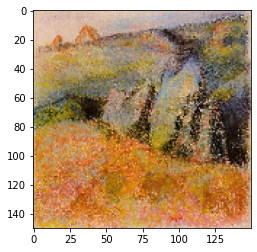

1/1 [==============================] - 0s 79ms/step
True label is: Edgar_Degas, CNN predicted Pierre Aguste Renoir with confidence 0.3963475823402405


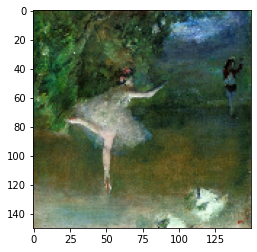

True label is: Edgar_Degas, CNN predicted Francisco Goya with confidence 0.39504218101501465


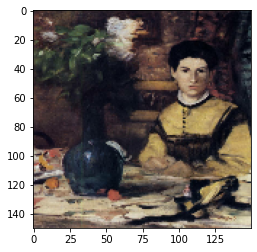

True label is: Edgar_Degas, CNN predicted Vincent van Gogh with confidence 0.49673202633857727


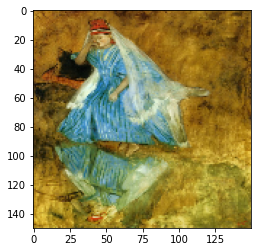

True label is: Edgar_Degas, CNN predicted Titian with confidence 0.28115737438201904


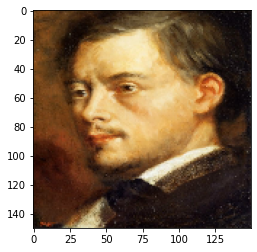

1/1 [==============================] - 0s 61ms/step
True label is: Edgar_Degas, CNN predicted Vincent van Gogh with confidence 0.49230897426605225


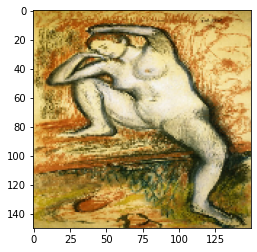

True label is: Edgar_Degas, CNN predicted Pablo Picasso with confidence 0.4623571038246155


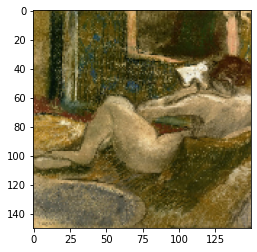

True label is: Edgar_Degas, CNN predicted Vincent van Gogh with confidence 0.4205394983291626


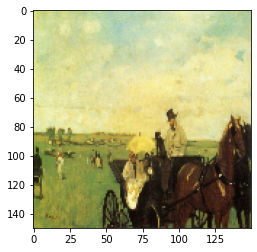

True label is: Edgar_Degas, CNN predicted Vincent van Gogh with confidence 0.6937304139137268


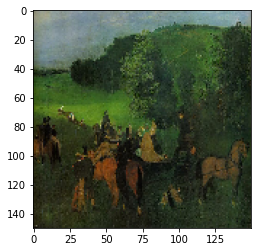

True label is: Edgar_Degas, CNN predicted Rembrandt with confidence 0.3731854259967804


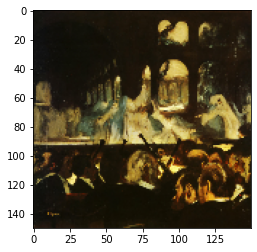

True label is: Edgar_Degas, CNN predicted Paul Gauguin with confidence 0.44413843750953674


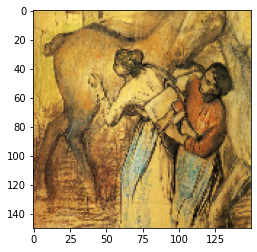

True label is: Edgar_Degas, CNN predicted Vincent van Gogh with confidence 0.39655646681785583


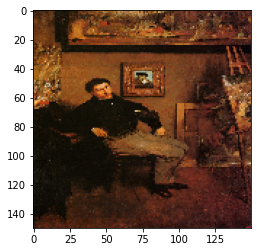

1/1 [==============================] - 0s 65ms/step
True label is: Edgar_Degas, CNN predicted Rembrandt with confidence 0.567203164100647


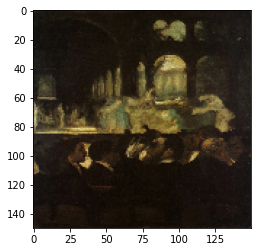

True label is: Edgar_Degas, CNN predicted Rembrandt with confidence 0.7436561584472656


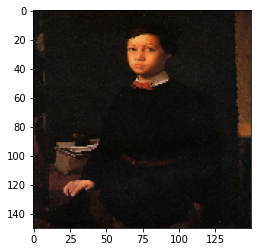

True label is: Edgar_Degas, CNN predicted Vincent van Gogh with confidence 0.4222964942455292


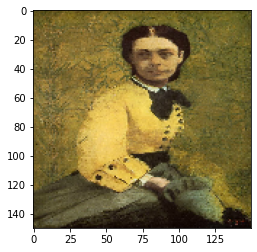

1/1 [==============================] - 0s 43ms/step
True label is: Edgar_Degas, CNN predicted Vincent van Gogh with confidence 0.8799172043800354


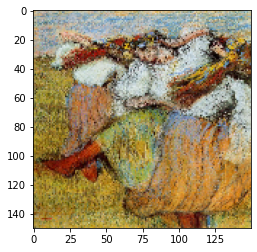

1/1 [==============================] - 0s 56ms/step
True label is: Edgar_Degas, CNN predicted Paul Gauguin with confidence 0.4498762786388397


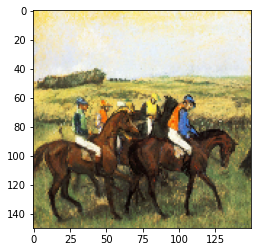

True label is: Edgar_Degas, CNN predicted Alfred Sisley with confidence 0.30697527527809143


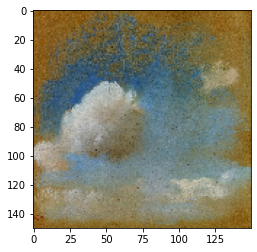

True label is: Edgar_Degas, CNN predicted Pierre Aguste Renoir with confidence 0.575661838054657


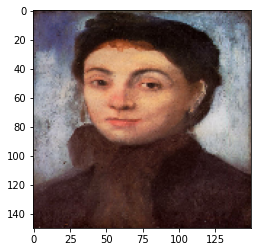

True label is: Edgar_Degas, CNN predicted Vincent van Gogh with confidence 0.32178544998168945


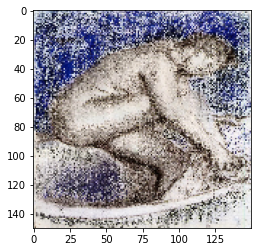

True label is: Edgar_Degas, CNN predicted Pablo Picasso with confidence 0.381646066904068


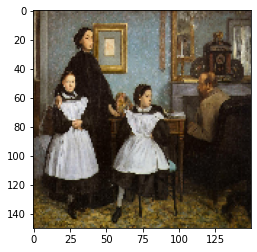

1/1 [==============================] - 0s 34ms/step
True label is: Edgar_Degas, CNN predicted Pablo Picasso with confidence 0.564520001411438


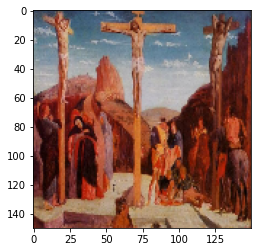

True label is: Edgar_Degas, CNN predicted Rembrandt with confidence 0.5183178782463074


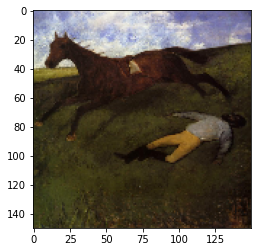

1/1 [==============================] - 0s 79ms/step
True label is: Edgar_Degas, CNN predicted Vincent van Gogh with confidence 0.8402093648910522


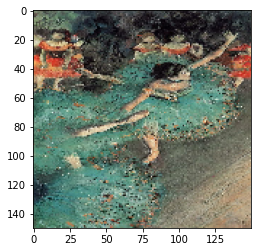

True label is: Edgar_Degas, CNN predicted Vincent van Gogh with confidence 0.49780207872390747


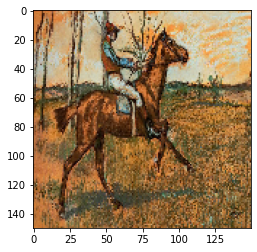

True label is: Edgar_Degas, CNN predicted Pablo Picasso with confidence 0.7288813591003418


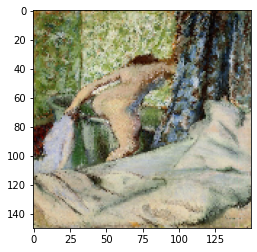

True label is: Edgar_Degas, CNN predicted Titian with confidence 0.3565429449081421


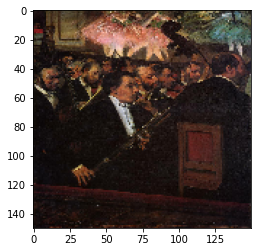

1/1 [==============================] - 0s 48ms/step
True label is: Edgar_Degas, CNN predicted Vincent van Gogh with confidence 0.821922242641449


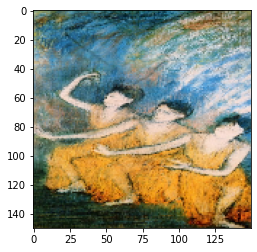

True label is: Edgar_Degas, CNN predicted Pablo Picasso with confidence 0.4545563757419586


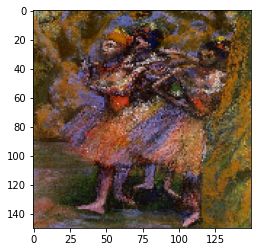

True label is: Edgar_Degas, CNN predicted Titian with confidence 0.4792230725288391


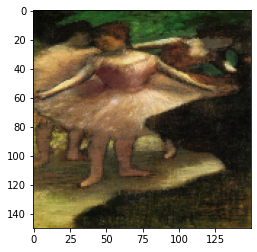

True label is: Edgar_Degas, CNN predicted Pierre Aguste Renoir with confidence 0.6274700164794922


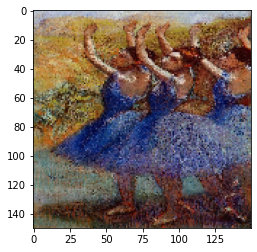

True label is: Edgar_Degas, CNN predicted Vincent van Gogh with confidence 0.35311684012413025


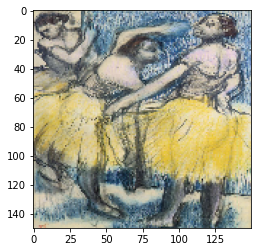

1/1 [==============================] - 0s 89ms/step
True label is: Edgar_Degas, CNN predicted Vincent van Gogh with confidence 0.3556157350540161


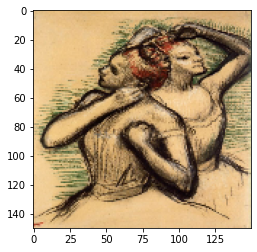

True label is: Edgar_Degas, CNN predicted Pierre Aguste Renoir with confidence 0.4439971148967743


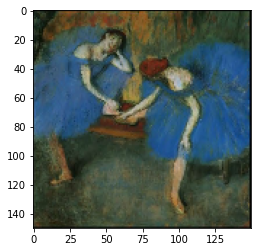

True label is: Edgar_Degas, CNN predicted Pierre Aguste Renoir with confidence 0.40071386098861694


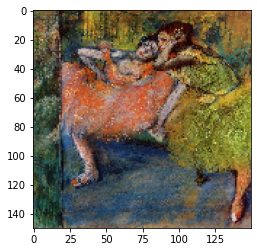

True label is: Edgar_Degas, CNN predicted Pablo Picasso with confidence 0.5464137196540833


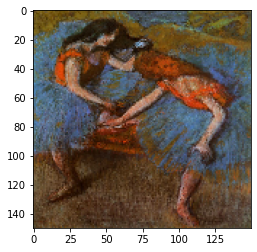

True label is: Edgar_Degas, CNN predicted Pablo Picasso with confidence 0.6391048431396484


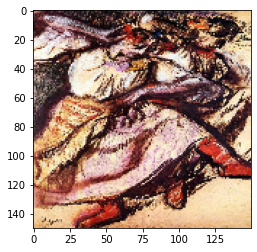

1/1 [==============================] - 0s 91ms/step
True label is: Edgar_Degas, CNN predicted Paul Gauguin with confidence 0.4118783175945282


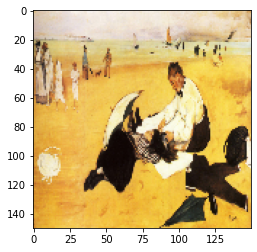

True label is: Edgar_Degas, CNN predicted Vincent van Gogh with confidence 0.5288292765617371


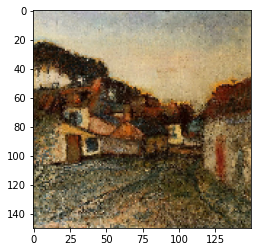

True label is: Edgar_Degas, CNN predicted Pablo Picasso with confidence 0.5859909653663635


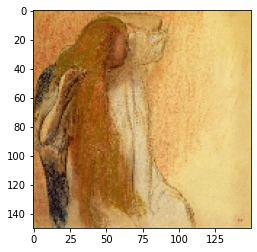

True label is: Edgar_Degas, CNN predicted Pierre Aguste Renoir with confidence 0.44422706961631775


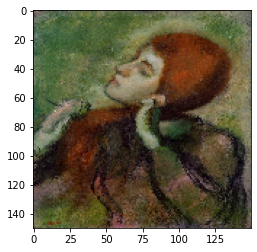

True label is: Edgar_Degas, CNN predicted Pablo Picasso with confidence 0.7859772443771362


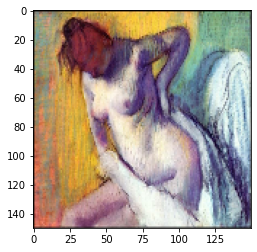

1/1 [==============================] - 0s 50ms/step
True label is: Edgar_Degas, CNN predicted Vincent van Gogh with confidence 0.416460782289505


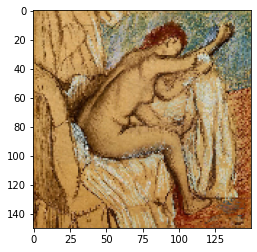

True label is: Edgar_Degas, CNN predicted Vincent van Gogh with confidence 0.45822522044181824


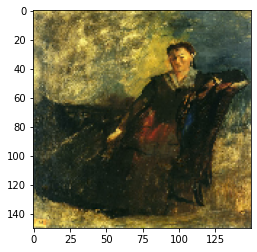

True label is: Edgar_Degas, CNN predicted Marc Chagall with confidence 0.7803792357444763


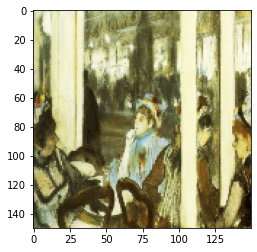

1/1 [==============================] - 0s 72ms/step
True label is: Edgar_Degas, CNN predicted Pablo Picasso with confidence 0.619164228439331


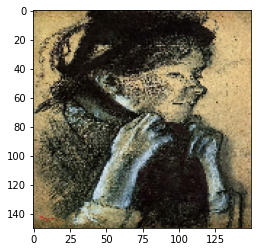

True label is: Edgar_Degas, CNN predicted Pablo Picasso with confidence 0.5248087644577026


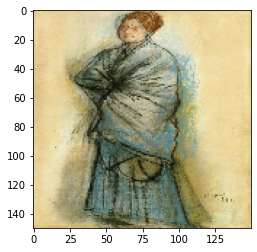

True label is: Edgar_Degas, CNN predicted Vincent van Gogh with confidence 0.5226553678512573


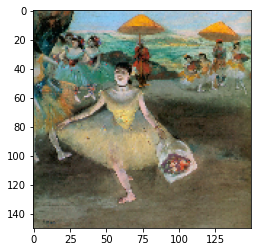

1/1 [==============================] - 0s 81ms/step
True label is: Edgar_Degas, CNN predicted Pablo Picasso with confidence 0.8403879404067993


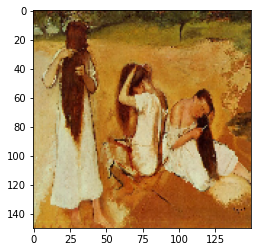

True label is: Edgar_Degas, CNN predicted Pablo Picasso with confidence 0.7793107032775879


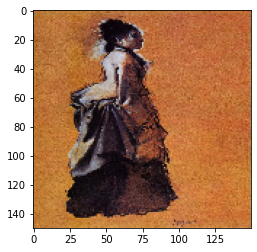

True label is: Edgar_Degas, CNN predicted Paul Gauguin with confidence 0.8283215761184692


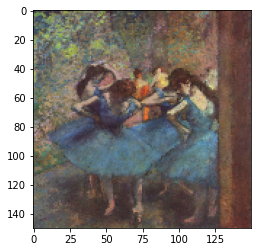

True label is: Edgar_Degas, CNN predicted Alfred Sisley with confidence 0.5795239210128784


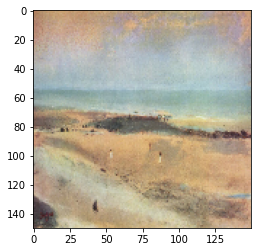

True label is: Edgar_Degas, CNN predicted Francisco Goya with confidence 0.3766540288925171


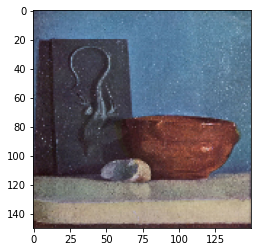

1/1 [==============================] - 0s 87ms/step
True label is: Edgar_Degas, CNN predicted Pablo Picasso with confidence 0.3056040406227112


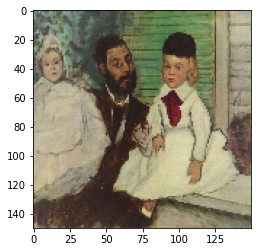

1/1 [==============================] - 0s 78ms/step
True label is: Edgar_Degas, CNN predicted Vincent van Gogh with confidence 0.3356439769268036


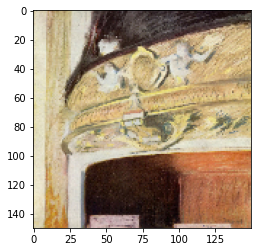

True label is: Edgar_Degas, CNN predicted Paul Gauguin with confidence 0.35767149925231934


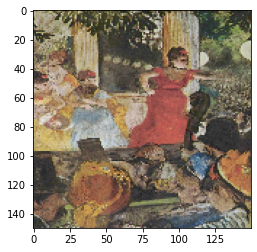

True label is: Edgar_Degas, CNN predicted Paul Gauguin with confidence 0.7475844025611877


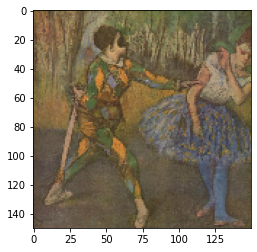

True label is: Edgar_Degas, CNN predicted Paul Gauguin with confidence 0.5227919816970825


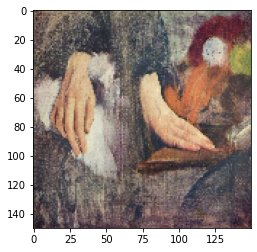

True label is: Edgar_Degas, CNN predicted Vincent van Gogh with confidence 0.31034183502197266


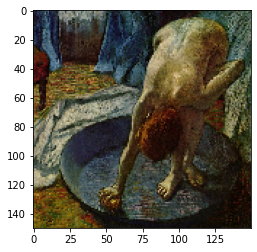

1/1 [==============================] - 0s 29ms/step
True label is: Edgar_Degas, CNN predicted Vincent van Gogh with confidence 0.4125153124332428


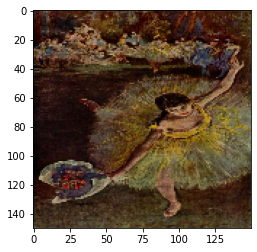

True label is: Edgar_Degas, CNN predicted Pablo Picasso with confidence 0.36472105979919434


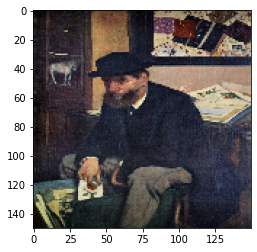

1/1 [==============================] - 0s 30ms/step
True label is: Edgar_Degas, CNN predicted Vincent van Gogh with confidence 0.47005972266197205


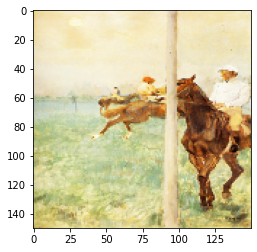

True label is: Edgar_Degas, CNN predicted Francisco Goya with confidence 0.36868977546691895


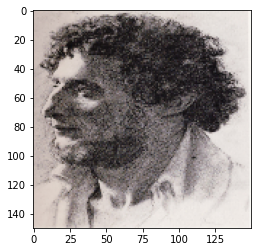

True label is: Edgar_Degas, CNN predicted Pablo Picasso with confidence 0.7781432867050171


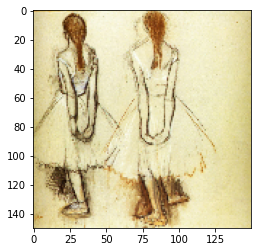

1/1 [==============================] - 0s 85ms/step
True label is: Edgar_Degas, CNN predicted Vincent van Gogh with confidence 0.24177177250385284


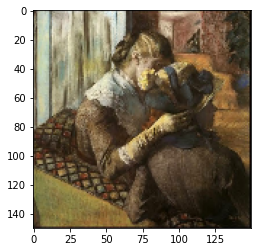

True label is: Edgar_Degas, CNN predicted Pablo Picasso with confidence 0.6556012630462646


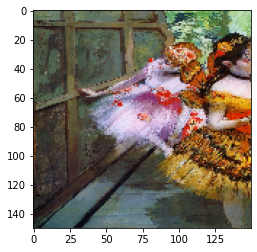

True label is: Edgar_Degas, CNN predicted Rembrandt with confidence 0.39931562542915344


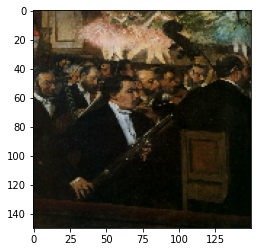

True label is: Edgar_Degas, CNN predicted Paul Gauguin with confidence 0.3579573631286621


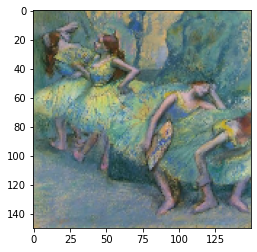

True label is: Edgar_Degas, CNN predicted Vincent van Gogh with confidence 0.4010717272758484


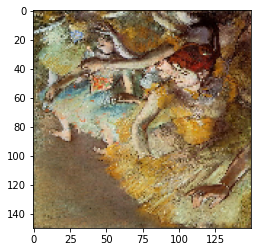

True label is: Edgar_Degas, CNN predicted Pablo Picasso with confidence 0.4519217312335968


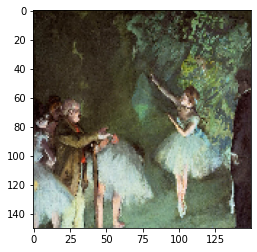

1/1 [==============================] - 0s 64ms/step
True label is: Edgar_Degas, CNN predicted Pablo Picasso with confidence 0.5236457586288452


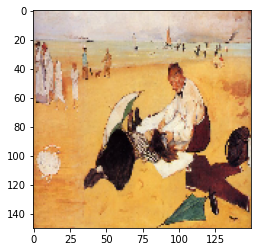

True label is: Francisco Goya, CNN predicted Vincent van Gogh with confidence 0.903956413269043


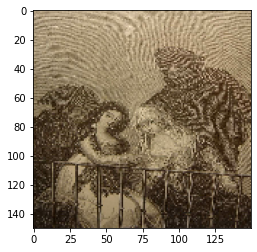

True label is: Francisco Goya, CNN predicted Pablo Picasso with confidence 0.6393342614173889


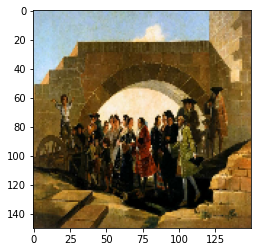

True label is: Francisco Goya, CNN predicted Vincent van Gogh with confidence 0.45569685101509094


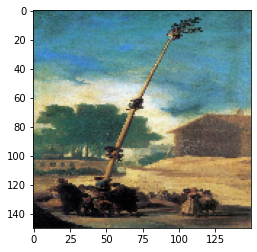

True label is: Francisco Goya, CNN predicted Paul Gauguin with confidence 0.7371208667755127


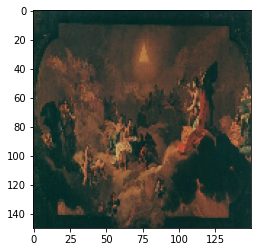

True label is: Francisco Goya, CNN predicted Rembrandt with confidence 0.5030487179756165


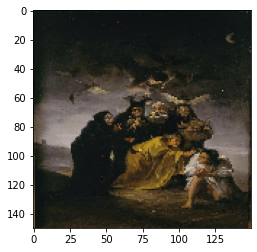

1/1 [==============================] - 0s 41ms/step
True label is: Francisco Goya, CNN predicted Vincent van Gogh with confidence 0.43592211604118347


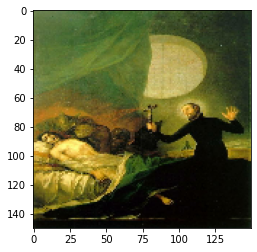

True label is: Francisco Goya, CNN predicted Edgar_Degas with confidence 0.366214394569397


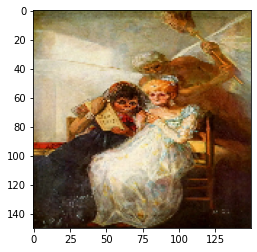

True label is: Francisco Goya, CNN predicted Vincent van Gogh with confidence 0.3807402551174164


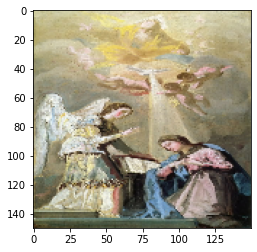

True label is: Francisco Goya, CNN predicted Edgar_Degas with confidence 0.4854397177696228


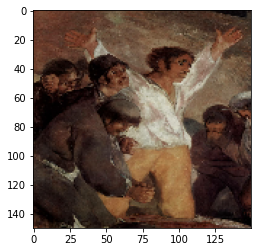

True label is: Francisco Goya, CNN predicted Rembrandt with confidence 0.4079017639160156


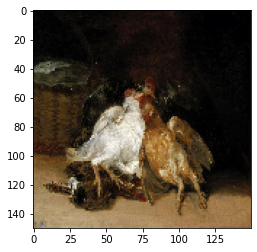

True label is: Francisco Goya, CNN predicted Edgar_Degas with confidence 0.5839175581932068


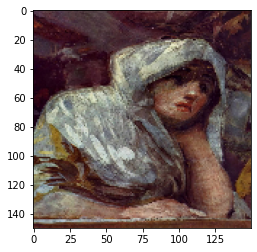

True label is: Francisco Goya, CNN predicted Pablo Picasso with confidence 0.5762901306152344


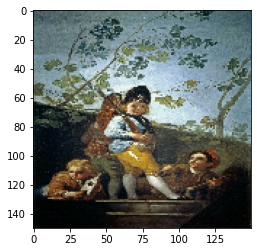

True label is: Francisco Goya, CNN predicted Rembrandt with confidence 0.3154335916042328


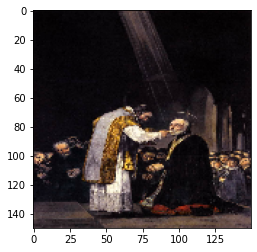

1/1 [==============================] - 0s 72ms/step
True label is: Francisco Goya, CNN predicted Rembrandt with confidence 0.30739787220954895


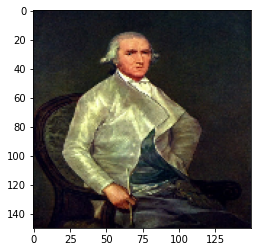

True label is: Francisco Goya, CNN predicted Alfred Sisley with confidence 0.892016589641571


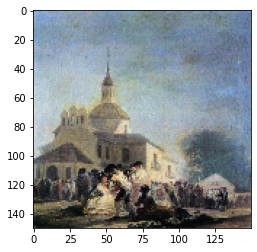

True label is: Francisco Goya, CNN predicted Rembrandt with confidence 0.7108781933784485


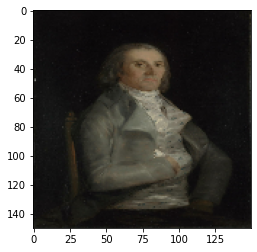

True label is: Francisco Goya, CNN predicted Edgar_Degas with confidence 0.8400406241416931


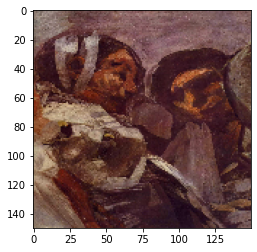

True label is: Francisco Goya, CNN predicted Edgar_Degas with confidence 0.29680079221725464


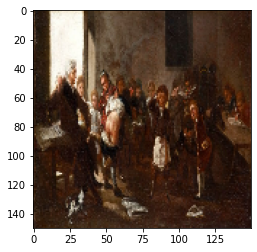

True label is: Francisco Goya, CNN predicted Titian with confidence 0.4048718214035034


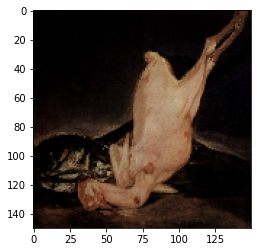

1/1 [==============================] - 0s 49ms/step
True label is: Francisco Goya, CNN predicted Titian with confidence 0.2563464045524597


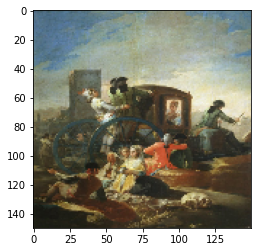

True label is: Francisco Goya, CNN predicted Rembrandt with confidence 0.3806874454021454


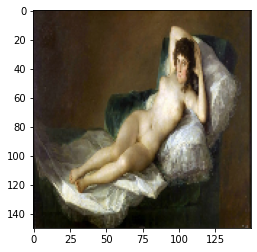

True label is: Francisco Goya, CNN predicted Vincent van Gogh with confidence 0.6074838042259216


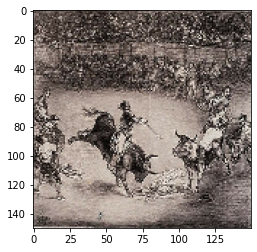

True label is: Francisco Goya, CNN predicted Pablo Picasso with confidence 0.3876754343509674


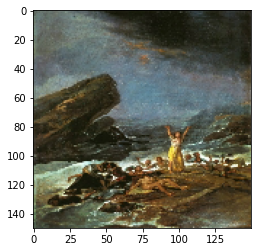

True label is: Francisco Goya, CNN predicted Titian with confidence 0.34910497069358826


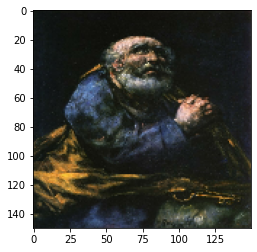

True label is: Francisco Goya, CNN predicted Titian with confidence 0.6827391386032104


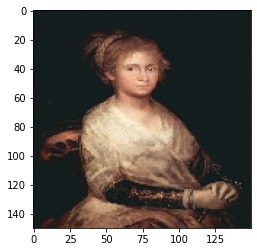

True label is: Francisco Goya, CNN predicted Edgar_Degas with confidence 0.5525590181350708


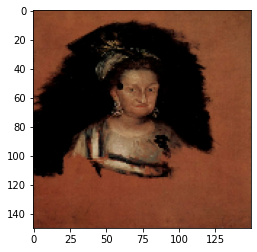

True label is: Francisco Goya, CNN predicted Vincent van Gogh with confidence 0.6871736645698547


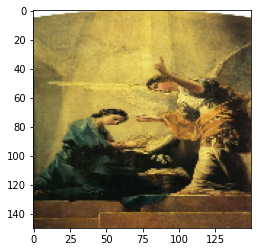

1/1 [==============================] - 0s 40ms/step
True label is: Francisco Goya, CNN predicted Edgar_Degas with confidence 0.6030233502388


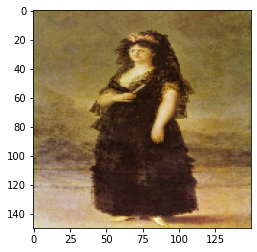

True label is: Francisco Goya, CNN predicted Vincent van Gogh with confidence 0.3348845839500427


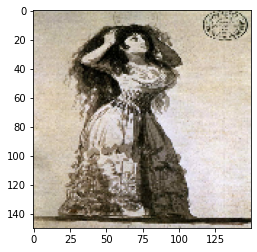

True label is: Francisco Goya, CNN predicted Pablo Picasso with confidence 0.3227733373641968


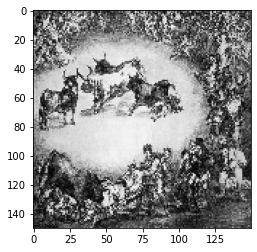

True label is: Francisco Goya, CNN predicted Vincent van Gogh with confidence 0.2928254306316376


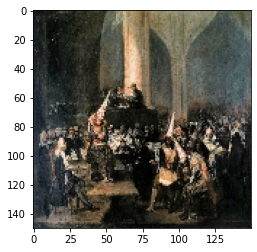

True label is: Francisco Goya, CNN predicted Pierre Aguste Renoir with confidence 0.4352057874202728


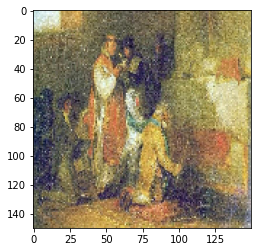

True label is: Francisco Goya, CNN predicted Titian with confidence 0.43391096591949463


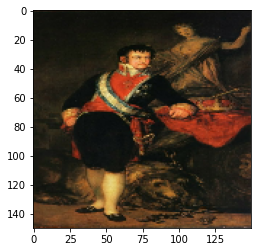

True label is: Francisco Goya, CNN predicted Rembrandt with confidence 0.7974487543106079


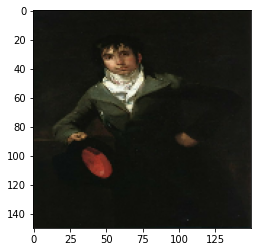

True label is: Francisco Goya, CNN predicted Rembrandt with confidence 0.3101373314857483


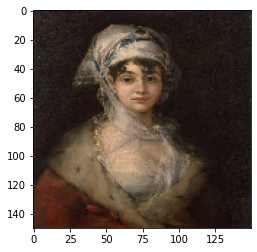

True label is: Francisco Goya, CNN predicted Titian with confidence 0.3899044096469879


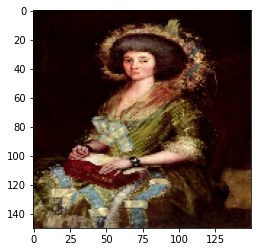

1/1 [==============================] - 0s 79ms/step
True label is: Francisco Goya, CNN predicted Rembrandt with confidence 0.5367656946182251


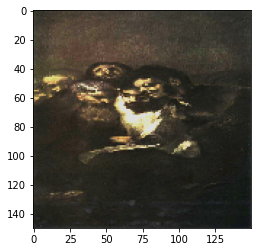

True label is: Francisco Goya, CNN predicted Rembrandt with confidence 0.2857937216758728


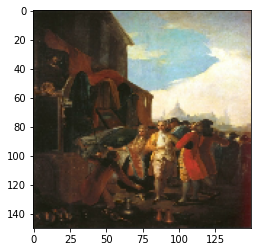

True label is: Francisco Goya, CNN predicted Edgar_Degas with confidence 0.3965604901313782


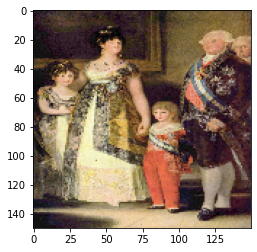

True label is: Francisco Goya, CNN predicted Albrecht_Durer with confidence 0.5209457874298096


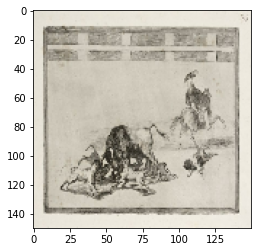

True label is: Francisco Goya, CNN predicted Edgar_Degas with confidence 0.33323901891708374


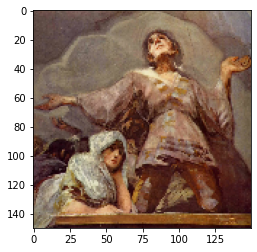

True label is: Francisco Goya, CNN predicted Edgar_Degas with confidence 0.5169680714607239


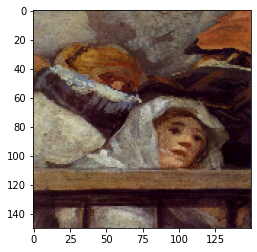

True label is: Francisco Goya, CNN predicted Titian with confidence 0.34945398569107056


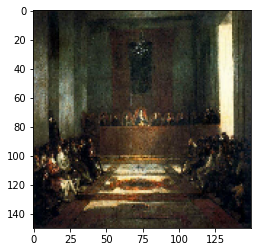

True label is: Francisco Goya, CNN predicted Pablo Picasso with confidence 0.4057982563972473


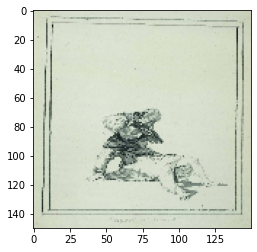

1/1 [==============================] - 0s 63ms/step
True label is: Francisco Goya, CNN predicted Edgar_Degas with confidence 0.6274333596229553


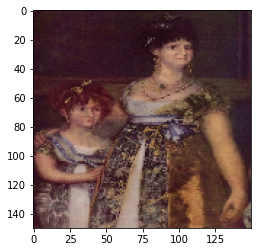

True label is: Francisco Goya, CNN predicted Pablo Picasso with confidence 0.5743134021759033


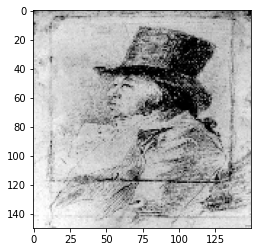

True label is: Francisco Goya, CNN predicted Edgar_Degas with confidence 0.3091987371444702


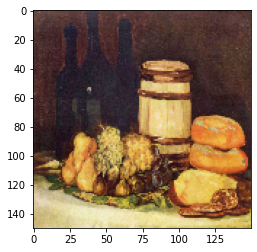

True label is: Francisco Goya, CNN predicted Albrecht_Durer with confidence 0.4073171019554138


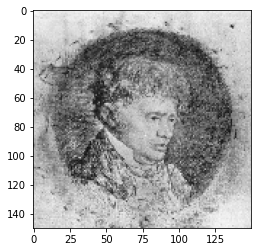

True label is: Francisco Goya, CNN predicted Pablo Picasso with confidence 0.4451149106025696


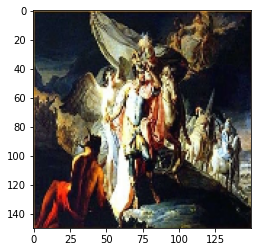

True label is: Francisco Goya, CNN predicted Vincent van Gogh with confidence 0.2869535982608795


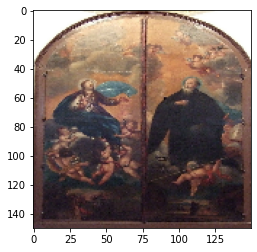

True label is: Francisco Goya, CNN predicted Albrecht_Durer with confidence 0.6660556793212891


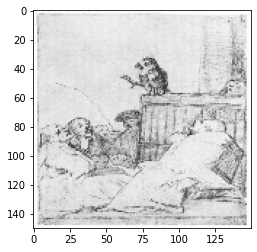

True label is: Francisco Goya, CNN predicted Albrecht_Durer with confidence 0.4963955283164978


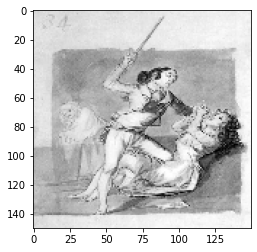

True label is: Francisco Goya, CNN predicted Vincent van Gogh with confidence 0.2904609441757202


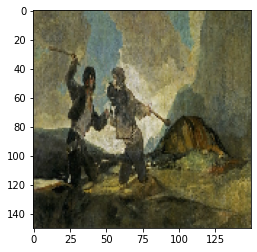

1/1 [==============================] - 0s 46ms/step
True label is: Francisco Goya, CNN predicted Vincent van Gogh with confidence 0.2436572164297104


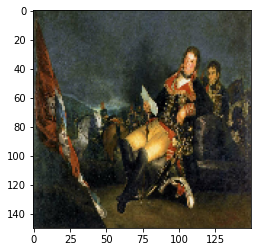

True label is: Francisco Goya, CNN predicted Titian with confidence 0.37574028968811035


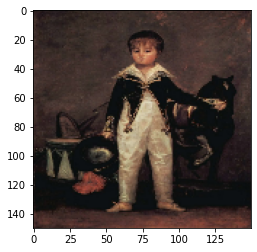

True label is: Francisco Goya, CNN predicted Rembrandt with confidence 0.45135900378227234


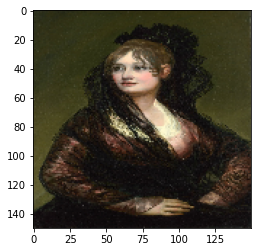

True label is: Francisco Goya, CNN predicted Pierre Aguste Renoir with confidence 0.515369176864624


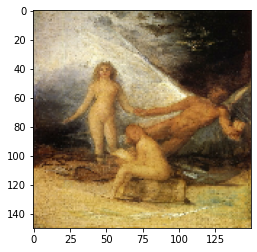

True label is: Francisco Goya, CNN predicted Titian with confidence 0.3885965049266815


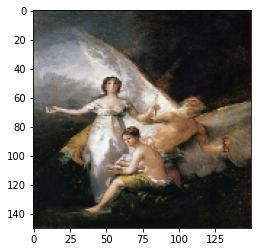

1/1 [==============================] - 0s 70ms/step
True label is: Francisco Goya, CNN predicted Vincent van Gogh with confidence 0.4035687744617462


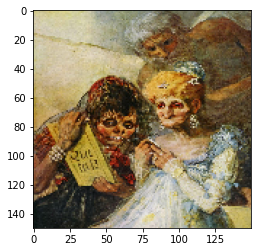

True label is: Francisco Goya, CNN predicted Edgar_Degas with confidence 0.4323153793811798


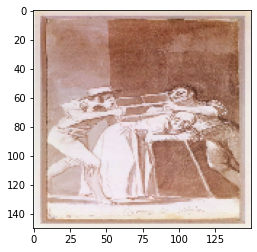

True label is: Francisco Goya, CNN predicted Rembrandt with confidence 0.3057030439376831


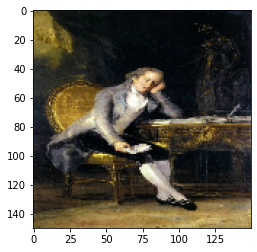

True label is: Francisco Goya, CNN predicted Vincent van Gogh with confidence 0.635597288608551


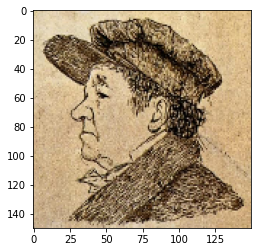

True label is: Francisco Goya, CNN predicted Rembrandt with confidence 0.5390563011169434


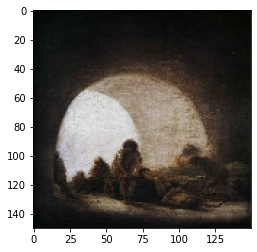

True label is: Francisco Goya, CNN predicted Titian with confidence 0.3241434395313263


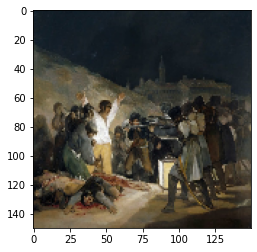

True label is: Francisco Goya, CNN predicted Pablo Picasso with confidence 0.5134849548339844


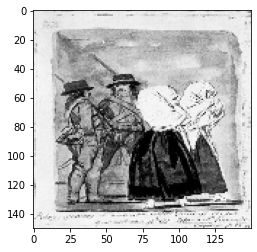

True label is: Francisco Goya, CNN predicted Pablo Picasso with confidence 0.7364055514335632


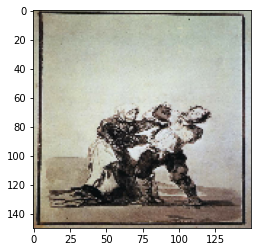

True label is: Francisco Goya, CNN predicted Rembrandt with confidence 0.356735497713089


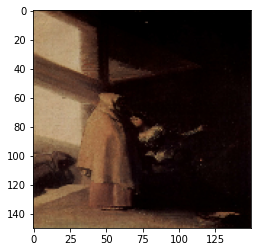

True label is: Francisco Goya, CNN predicted Rembrandt with confidence 0.5631915330886841


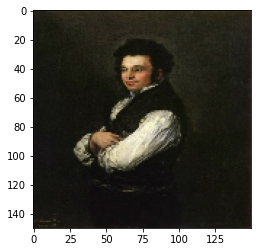

1/1 [==============================] - 0s 29ms/step
True label is: Francisco Goya, CNN predicted Rembrandt with confidence 0.5629121661186218


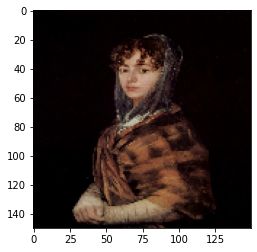

True label is: Francisco Goya, CNN predicted Rembrandt with confidence 0.45066630840301514


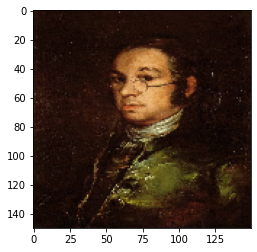

True label is: Francisco Goya, CNN predicted Alfred Sisley with confidence 0.918999195098877


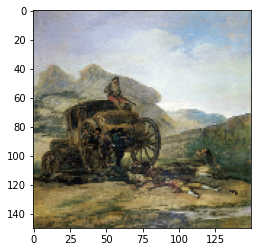

True label is: Francisco Goya, CNN predicted Rembrandt with confidence 0.7798604369163513


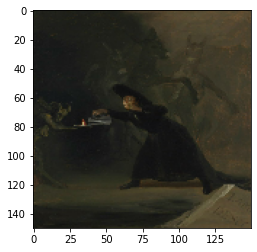

1/1 [==============================] - 0s 77ms/step
True label is: Francisco Goya, CNN predicted Pablo Picasso with confidence 0.5667994022369385


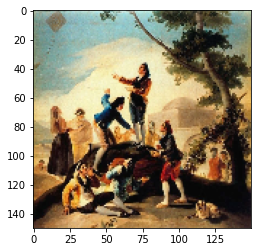

True label is: Francisco Goya, CNN predicted Pablo Picasso with confidence 0.7820872664451599


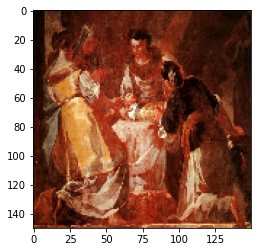

True label is: Francisco Goya, CNN predicted Edgar_Degas with confidence 0.5335030555725098


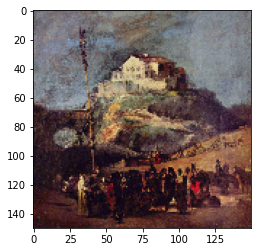

True label is: Francisco Goya, CNN predicted Pablo Picasso with confidence 0.9725914597511292


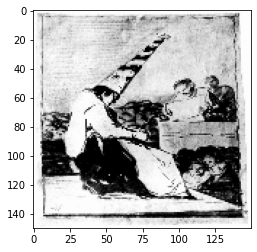

True label is: Francisco Goya, CNN predicted Paul Gauguin with confidence 0.43017297983169556


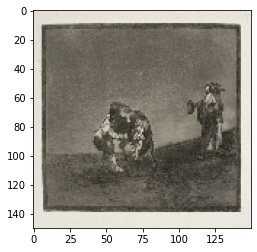

True label is: Francisco Goya, CNN predicted Titian with confidence 0.28930437564849854


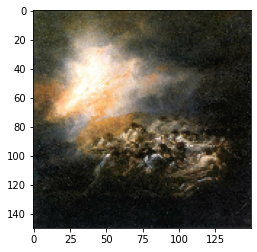

True label is: Francisco Goya, CNN predicted Rembrandt with confidence 0.7801963686943054


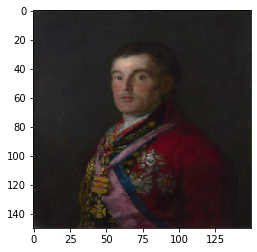

True label is: Francisco Goya, CNN predicted Edgar_Degas with confidence 0.6821659207344055


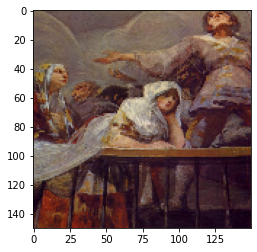

True label is: Francisco Goya, CNN predicted Titian with confidence 0.2984561622142792


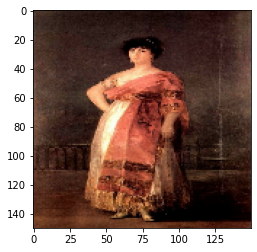

True label is: Francisco Goya, CNN predicted Rembrandt with confidence 0.5250292420387268


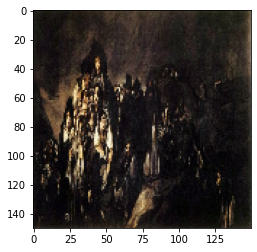

1/1 [==============================] - 0s 28ms/step
True label is: Francisco Goya, CNN predicted Vincent van Gogh with confidence 0.28245416283607483


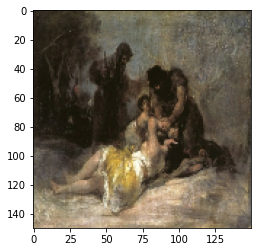

True label is: Marc Chagall, CNN predicted Pablo Picasso with confidence 0.6036433577537537


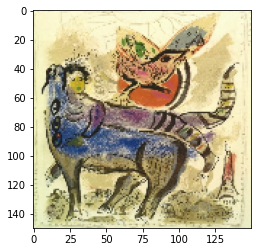

True label is: Marc Chagall, CNN predicted Francisco Goya with confidence 0.6755622625350952


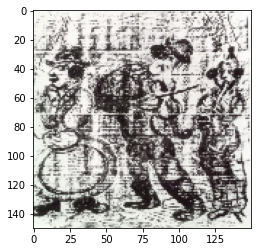

True label is: Marc Chagall, CNN predicted Francisco Goya with confidence 0.47766393423080444


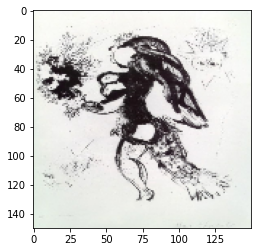

True label is: Marc Chagall, CNN predicted Pablo Picasso with confidence 0.620875895023346


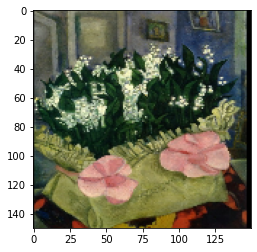

1/1 [==============================] - 0s 42ms/step
True label is: Marc Chagall, CNN predicted Pablo Picasso with confidence 0.9163321852684021


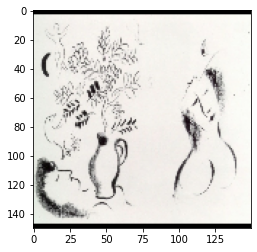

True label is: Marc Chagall, CNN predicted Francisco Goya with confidence 0.49059250950813293


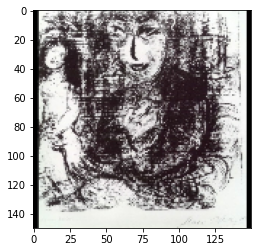

True label is: Marc Chagall, CNN predicted Pablo Picasso with confidence 0.5551820993423462


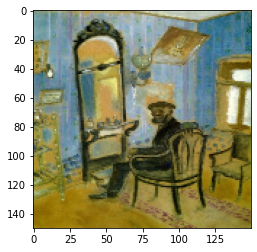

True label is: Marc Chagall, CNN predicted Francisco Goya with confidence 0.7760127186775208


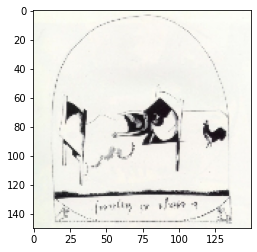

1/1 [==============================] - 0s 57ms/step
True label is: Marc Chagall, CNN predicted Francisco Goya with confidence 0.643821120262146


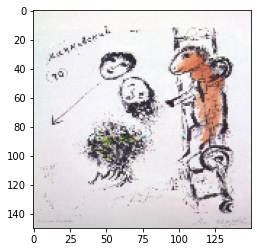

True label is: Marc Chagall, CNN predicted Pablo Picasso with confidence 0.9974416494369507


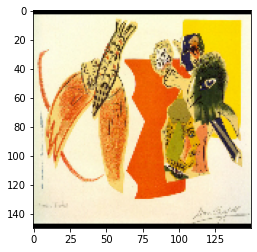

True label is: Marc Chagall, CNN predicted Vincent van Gogh with confidence 0.5508646368980408


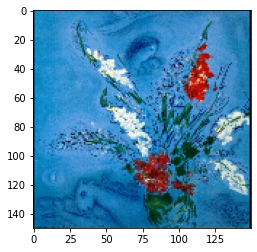

True label is: Marc Chagall, CNN predicted Pablo Picasso with confidence 0.8739092946052551


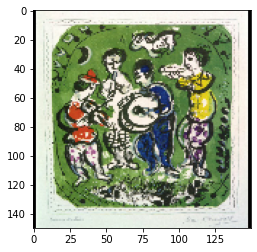

True label is: Marc Chagall, CNN predicted Pablo Picasso with confidence 0.9356006979942322


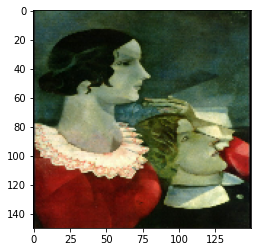

True label is: Marc Chagall, CNN predicted Vincent van Gogh with confidence 0.3824320435523987


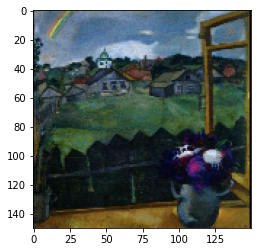

1/1 [==============================] - 0s 29ms/step
True label is: Marc Chagall, CNN predicted Pierre Aguste Renoir with confidence 0.34835270047187805


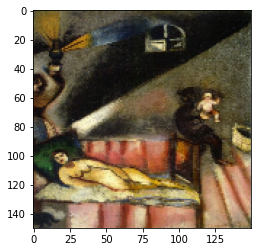

True label is: Marc Chagall, CNN predicted Pablo Picasso with confidence 0.5731377601623535


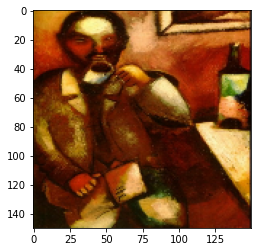

True label is: Marc Chagall, CNN predicted Vincent van Gogh with confidence 0.34813374280929565


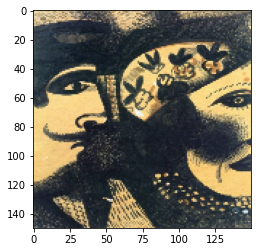

1/1 [==============================] - 0s 29ms/step
True label is: Marc Chagall, CNN predicted Pablo Picasso with confidence 0.5018320679664612


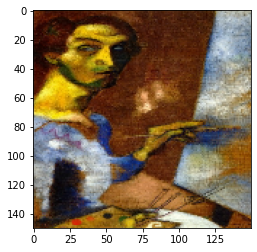

True label is: Marc Chagall, CNN predicted Vincent van Gogh with confidence 0.6924630999565125


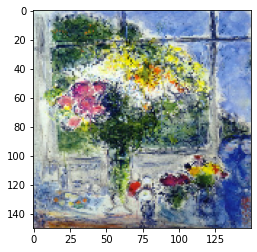

True label is: Marc Chagall, CNN predicted Pablo Picasso with confidence 0.9480317831039429


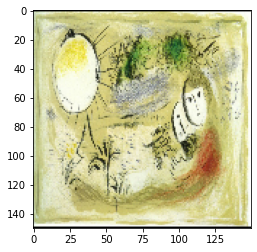

In [ ]:
#visualize the misclassified images
batch_size=16
test_size=1000
batch_index=0

for image_batch,label_batch in test_dataset:
  if batch_index > math.ceil(test_size/batch_size):
    break;

  y_pred = baseline_with_resaug.predict(image_batch)
  y_pred_labels=np.argmax(y_pred, axis=1)
  names=["Albrecht_Durer", "Alfred Sisley", "Edgar_Degas", "Francisco Goya", "Marc Chagall",
         "Pablo Picasso", "Paul Gauguin", "Pierre Aguste Renoir", "Rembrandt", "Titian", "Vincent van Gogh"]
  
  errors = np.where(y_pred_labels != label_batch)[0]

  for i in errors:
      true_class= label_batch[i]
      predicted_class= y_pred_labels[i]
      print(f"True label is: {names[true_class]}, CNN predicted {names[predicted_class]} with confidence {y_pred[i,predicted_class]}")
      plt.imshow(image_batch[i].numpy().astype("uint8"))
      plt.show()

  batch_index = batch_index+1